# <font color='purple'>Preprocessing QC statistics </font> 

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
import os
NOVA_HOME = '/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps'
NOVA_DATA_HOME = '/home/labs/hornsteinlab/Collaboration/MOmaps'
LOGS_PATH = os.path.join(NOVA_DATA_HOME, "outputs/preprocessing/spd/logs/preprocessing_Dec2023")
PLOT_PATH = os.path.join(NOVA_HOME, 'src', 'preprocessing', 'notebooks','figures','Neurons')
os.chdir(NOVA_HOME)
import pandas as pd
import contextlib
import io
from IPython.display import display, Javascript

from tools.preprocessing_tools.qc_utils import log_files_qc, run_validate_folder_structure, display_diff, sample_and_calc_variance, \
                                                show_site_survival_dapi_brenner, show_site_survival_dapi_cellpose, \
                                                show_site_survival_dapi_tiling, show_site_survival_target_brenner, \
                                                calc_total_sums, plot_filtering_heatmap, show_total_sum_tables, \
                                                plot_cell_count, plot_catplot, plot_hm_combine_batches, plot_hm, \
                                                run_calc_hist_new
                                                
from tools.preprocessing_tools.qc_config import panels, markers, marker_info, cell_lines, cell_lines_to_cond,\
                                    cell_lines_for_disp, reps, line_colors, lines_order, custom_palette,\
                                    expected_dapi_raw


In [4]:
df = log_files_qc(LOGS_PATH)
df_dapi = df[df.marker=='DAPI']
df_target = df[df.marker!='DAPI']

reading logs of batch4_original_with_brenner
reading logs of batch3_original_with_brenner
reading logs of batch9_original_with_brenner
reading logs of batch6_original_with_brenner
reading logs of batch7_original_with_brenner
reading logs of batch5_original_with_brenner
reading logs of batch8_original_with_brenner

Total of 12 files were read.
Before dup handeling  (398635, 22)
After duplication removal #1: (389910, 23)
After duplication removal #2: (384581, 23)


In [12]:
# choose batches
batches = [f'batch{i}' for i in range(3,10)]

## Actual Files Validation

### Raw Files Validation

1. How many site **tiff** files do we have in each folder?
2. Are all existing files valid? (tif, at least 2049kB, not corrupetd)

batch3
Folder structure is invalid. Missing paths:
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/FUSHomozygous/panelA
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/FUSHomozygous/panelB
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/FUSHomozygous/panelC
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/TDP43/panelA
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/TDP43/panelB
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/TDP43/panelC
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/TBK1/panelA
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/TBK1/panelB
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDisk/batch3/TBK1/panelC
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/raw/SpinningDis

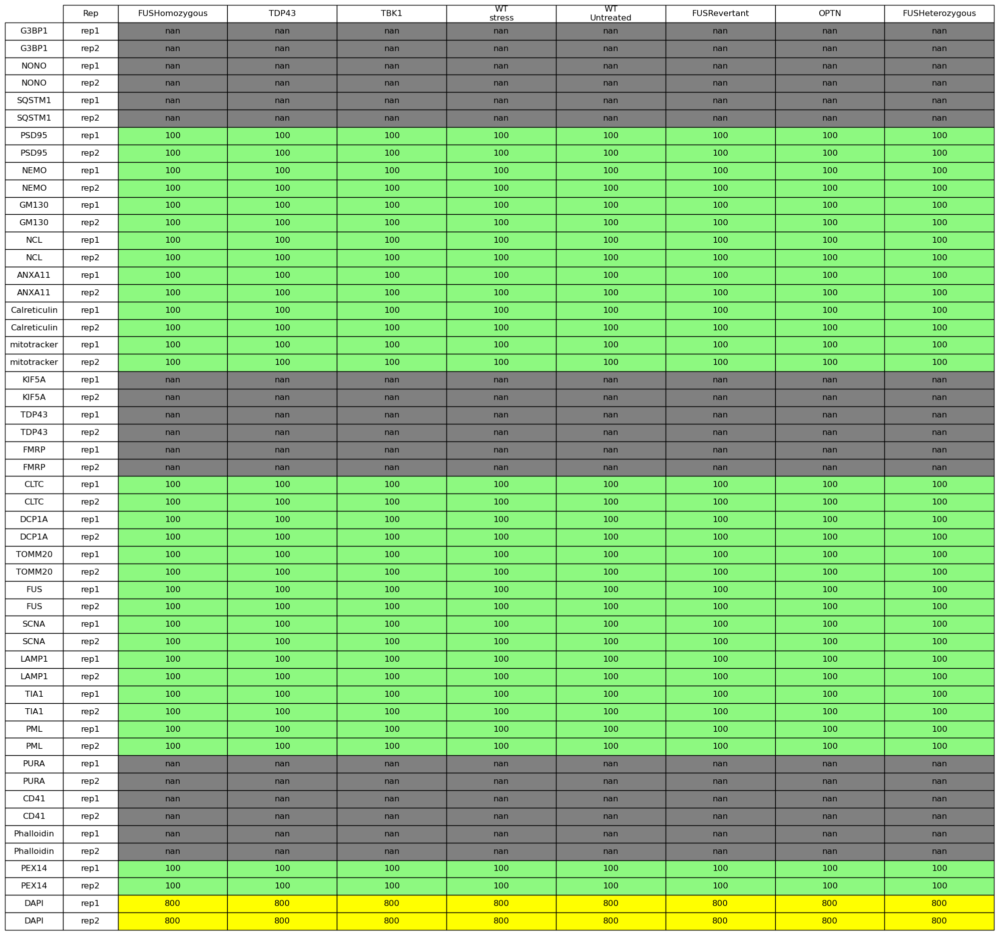

batch4
Folder structure is valid.
No bad files are found.
Total Sites:  57600


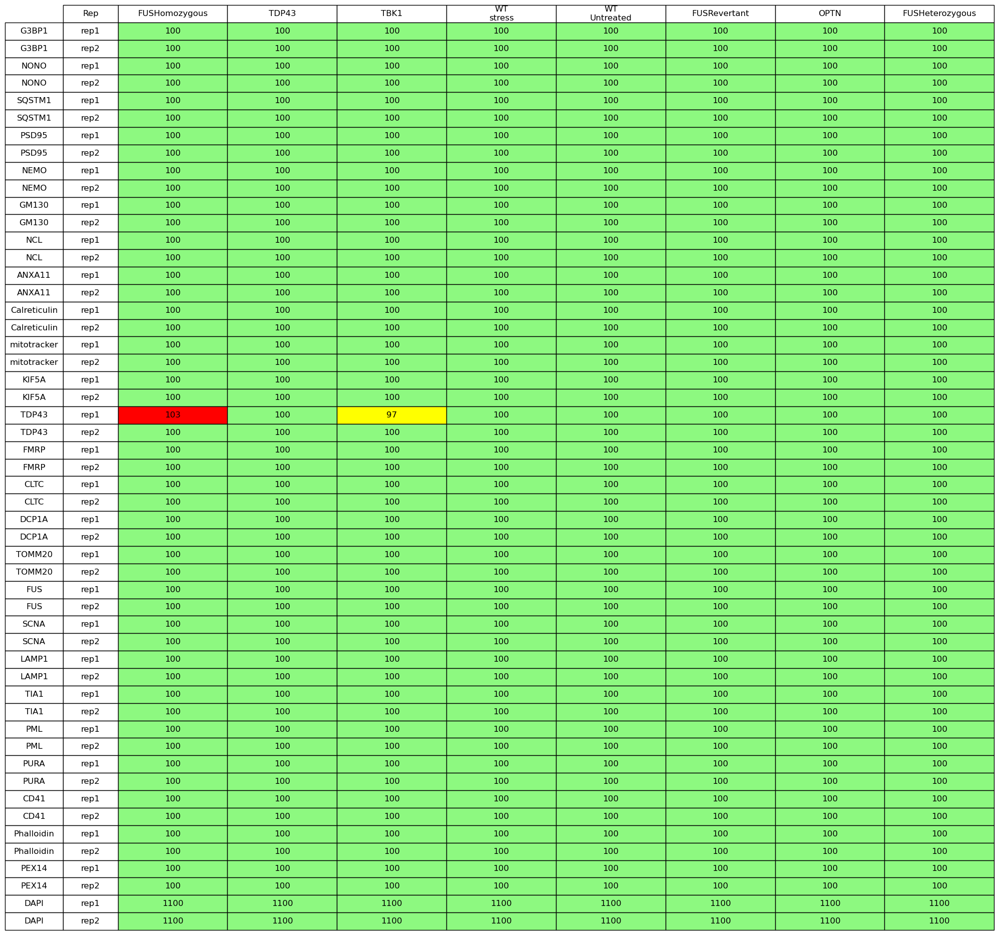

batch5
Folder structure is valid.
No bad files are found.
Total Sites:  57600


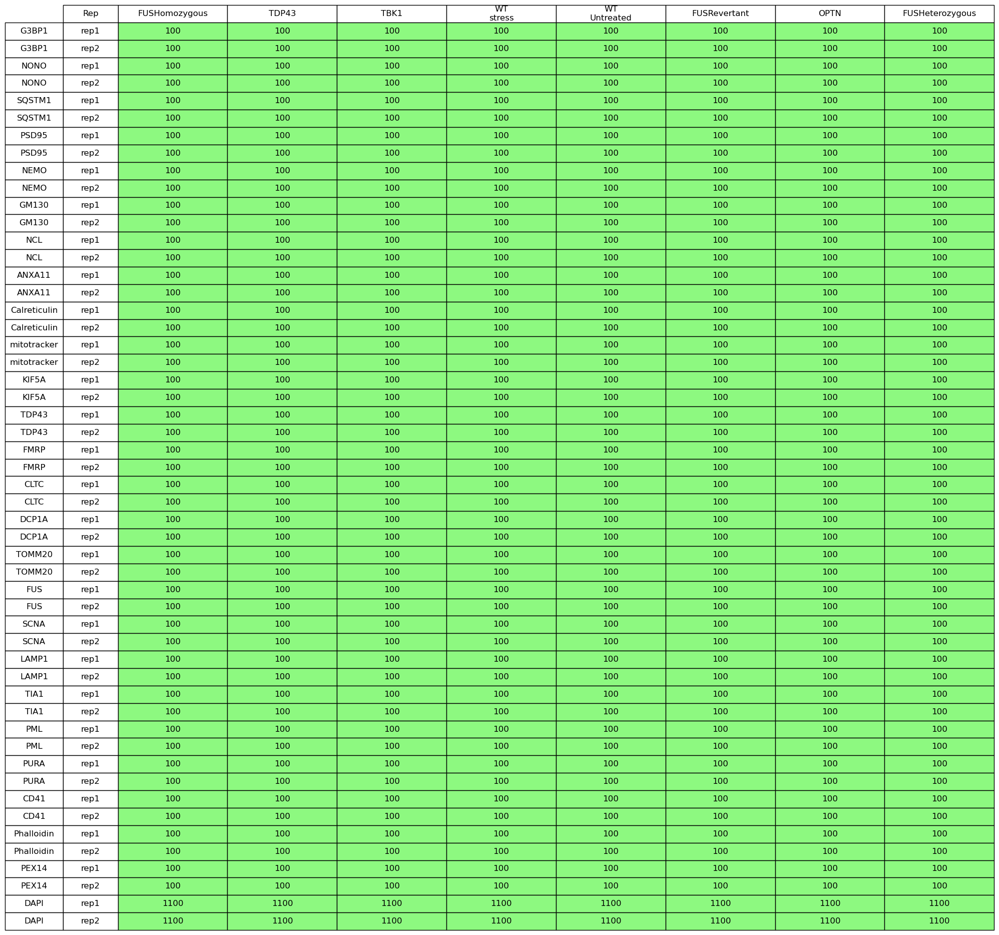

batch6
Folder structure is valid.
No bad files are found.
Total Sites:  57600


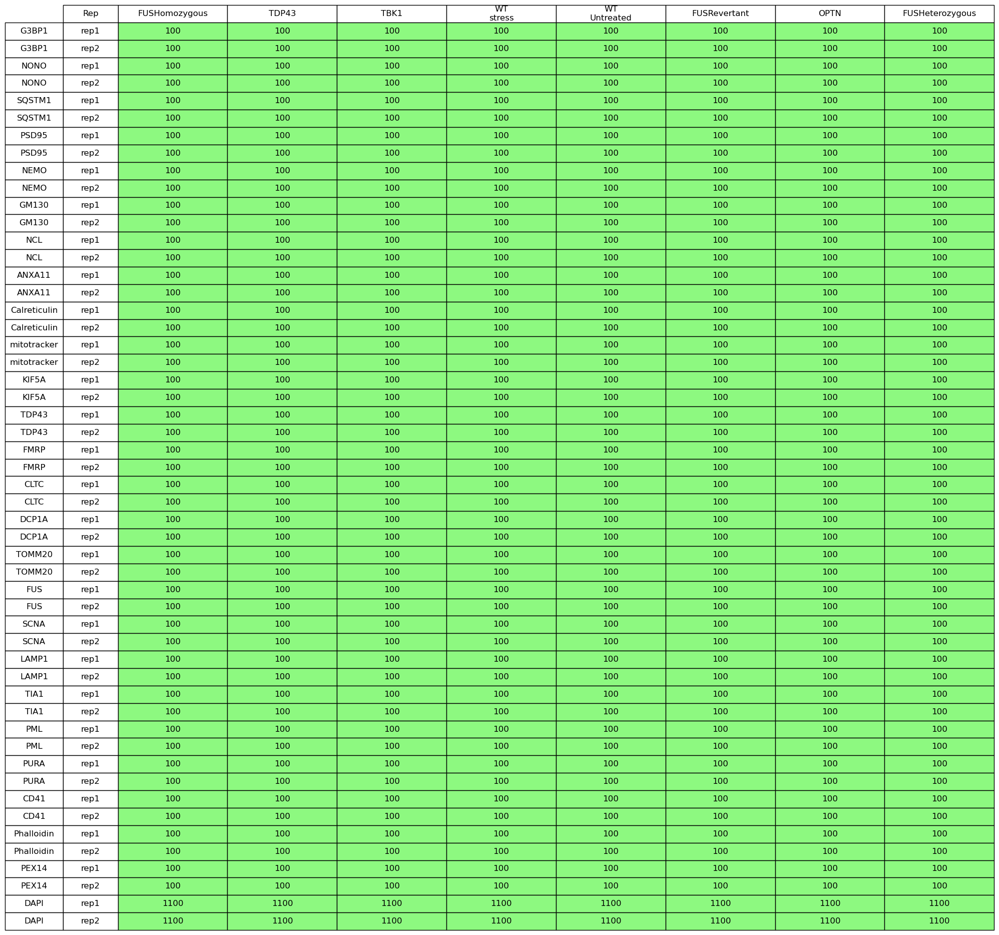

batch7
Folder structure is valid.
No bad files are found.
Total Sites:  57600


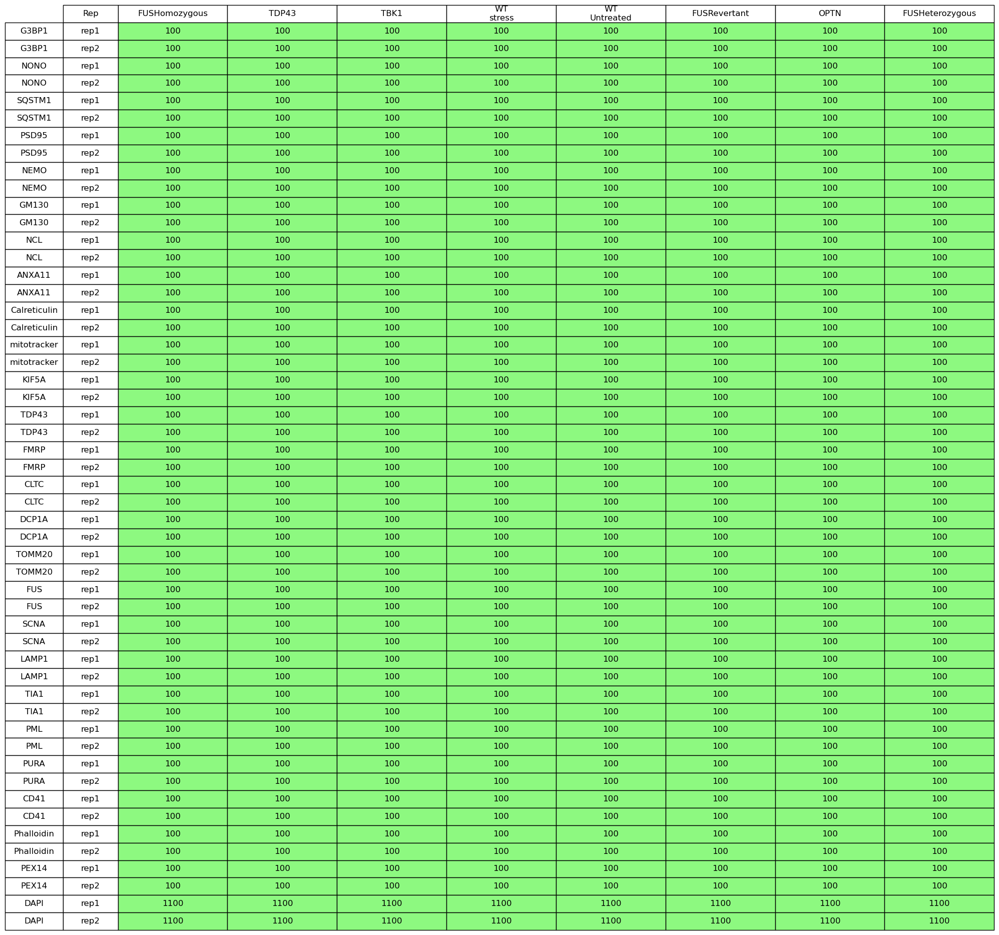

batch8
Folder structure is valid.
No bad files are found.
Total Sites:  57600


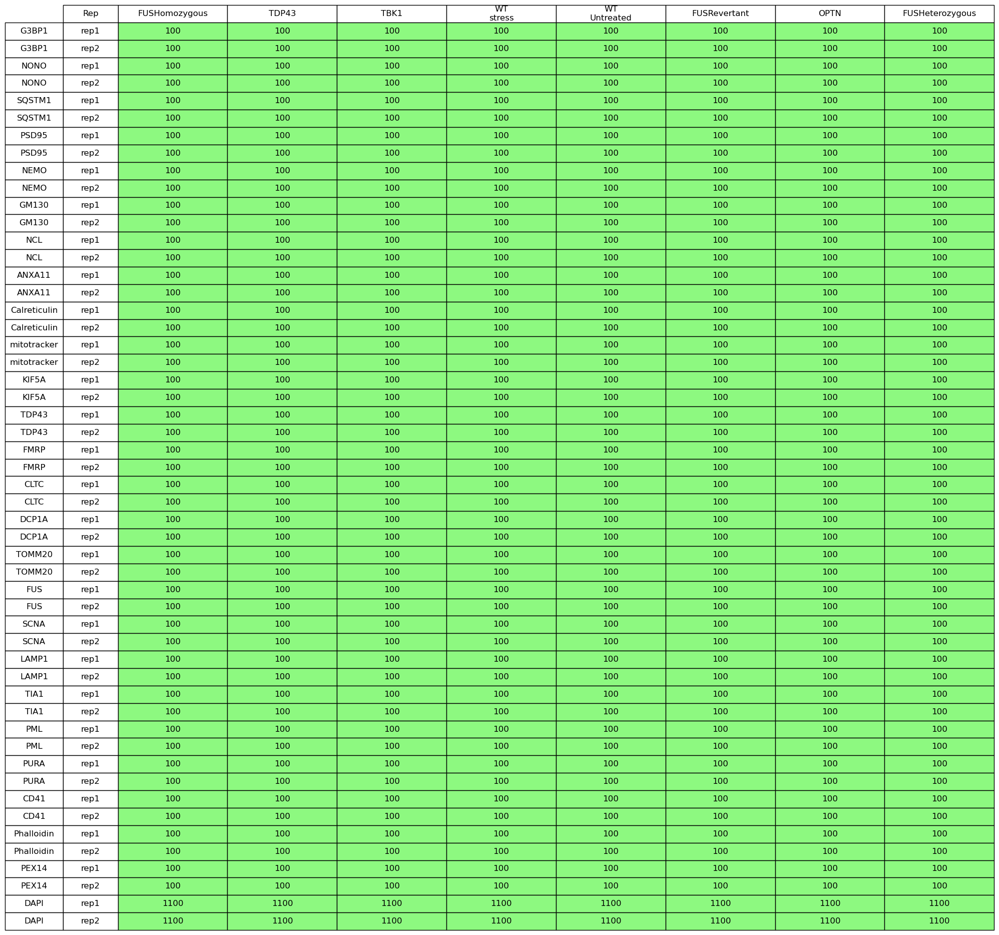

batch9
Folder structure is valid.
No bad files are found.
Total Sites:  57600


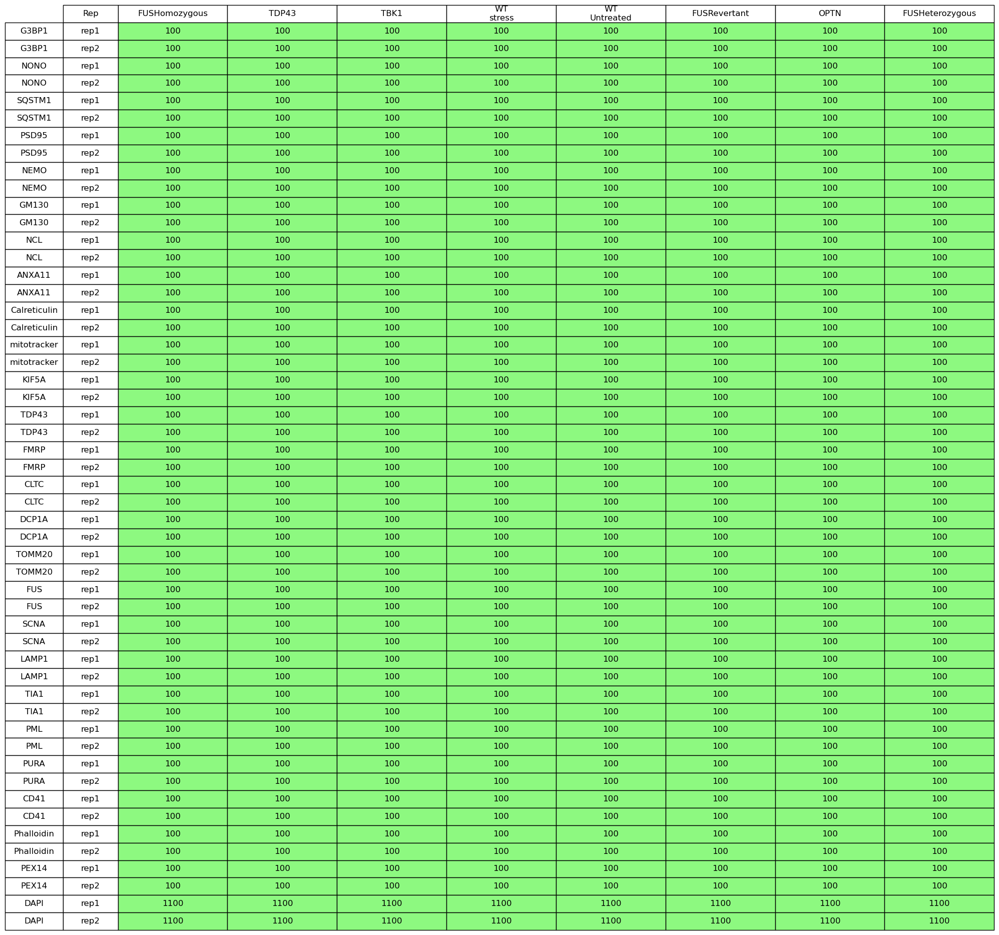

In [13]:

root_directory_raw = os.path.join(NOVA_DATA_HOME, 'input', 'images', 'raw', 'SpinningDisk')

batches_raw = [batch.replace("_16bit_no_downsample","") for batch in batches]
raws = run_validate_folder_structure(root_directory_raw, False, panels, markers,PLOT_PATH,marker_info,
                                    cell_lines_to_cond, reps, cell_lines_for_disp, expected_dapi_raw,
                                     batches=batches_raw)

### Processed Files Validation

1. How many site **npy** files do we have in each folder? -> How many sites survived the pre-processing?
2. Are all existing files valid? (at least 100kB, npy not corrupted)

batch3
Folder structure is invalid. Missing paths:
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/G3BP1
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/NONO
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/SQSTM1
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/KIF5A
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/TDP43
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/FMRP
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batch3/FUSHomozygous/Untreated/PURA
/home/labs/hornsteinlab/Collaboration/MOmaps/input/images/processed/spd2/SpinningDisk/batc

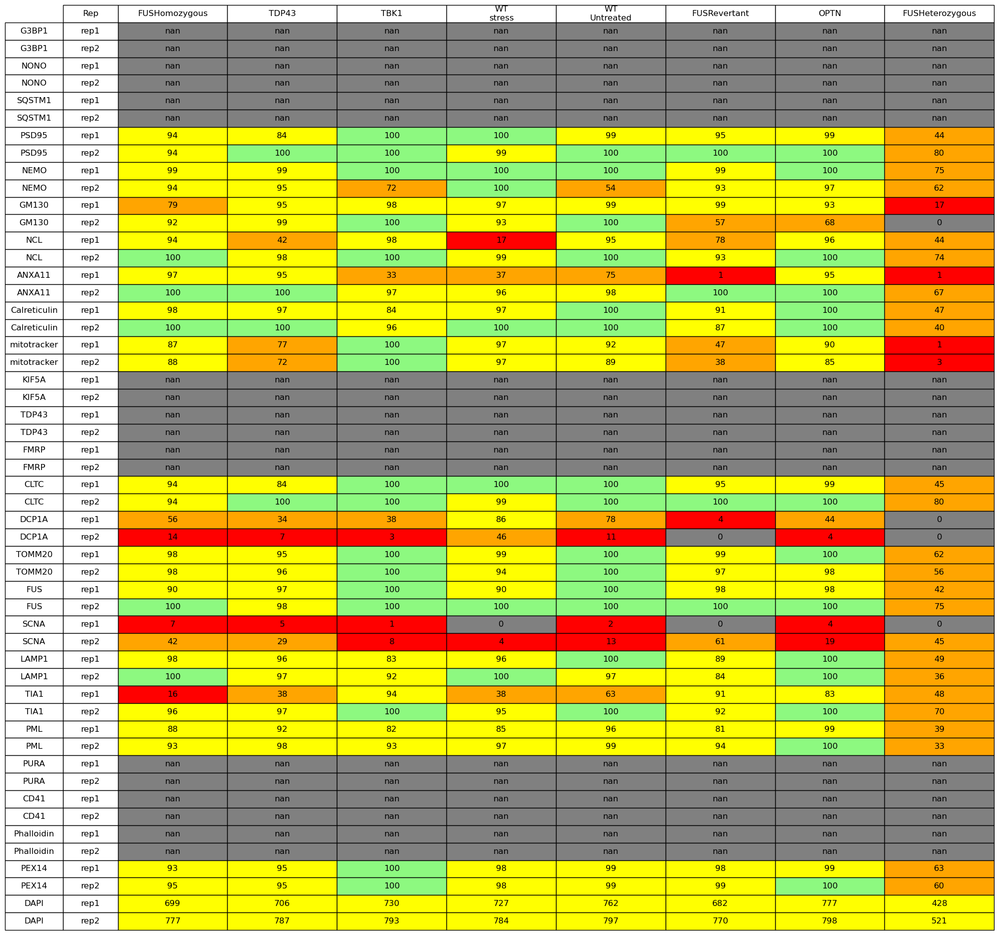

batch4
Folder structure is valid.
No bad files are found.
Total Sites:  44040


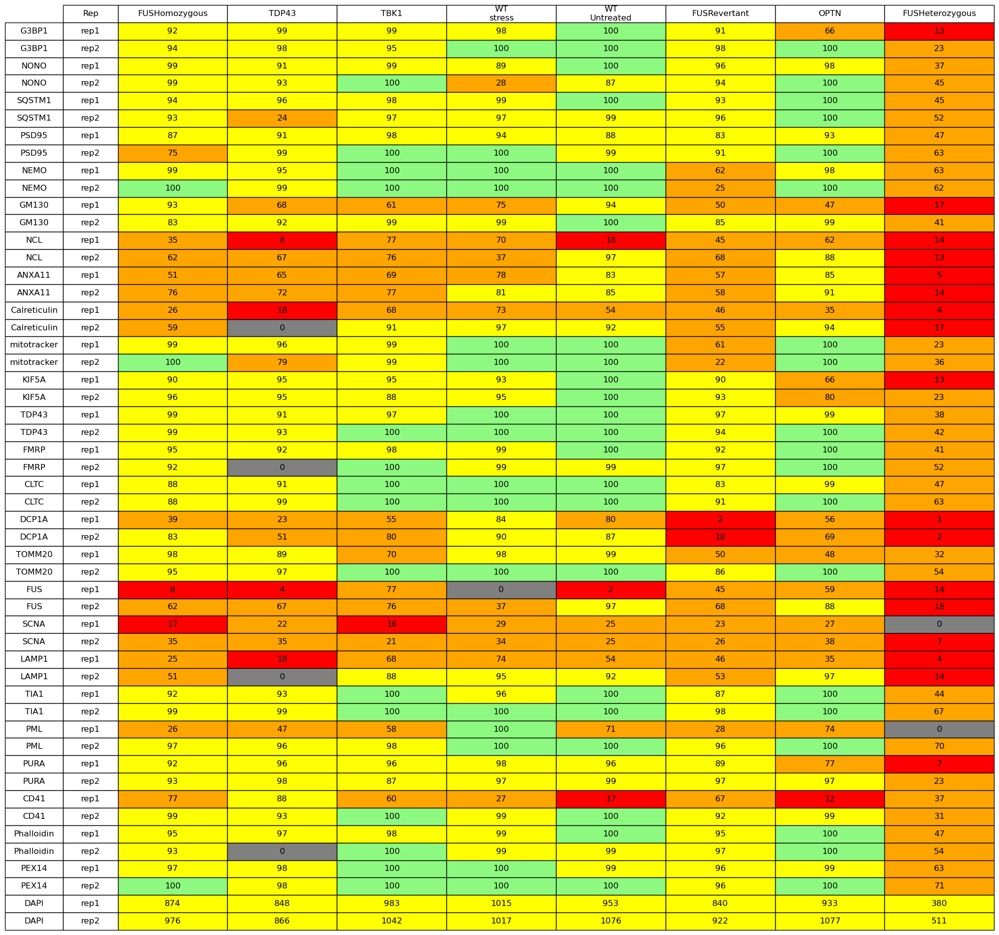

batch5
Folder structure is valid.
No bad files are found.
Total Sites:  47883


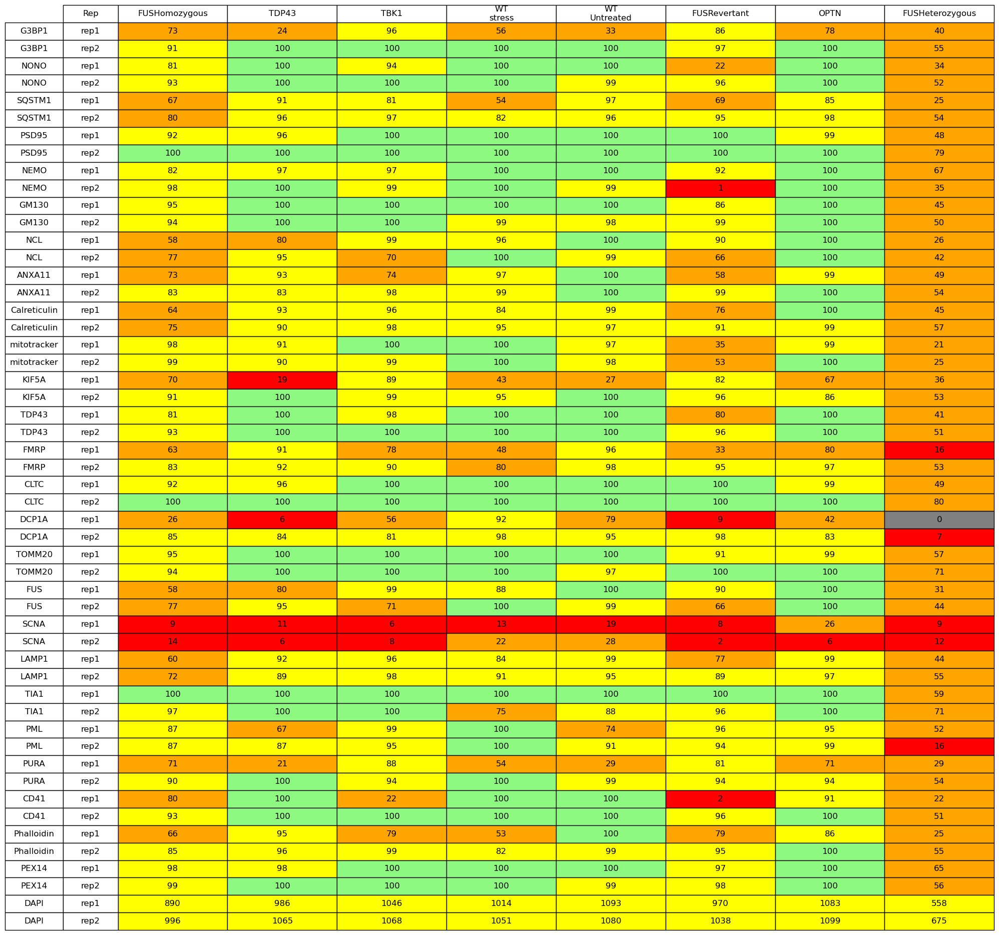

batch6
Folder structure is valid.
No bad files are found.
Total Sites:  55828


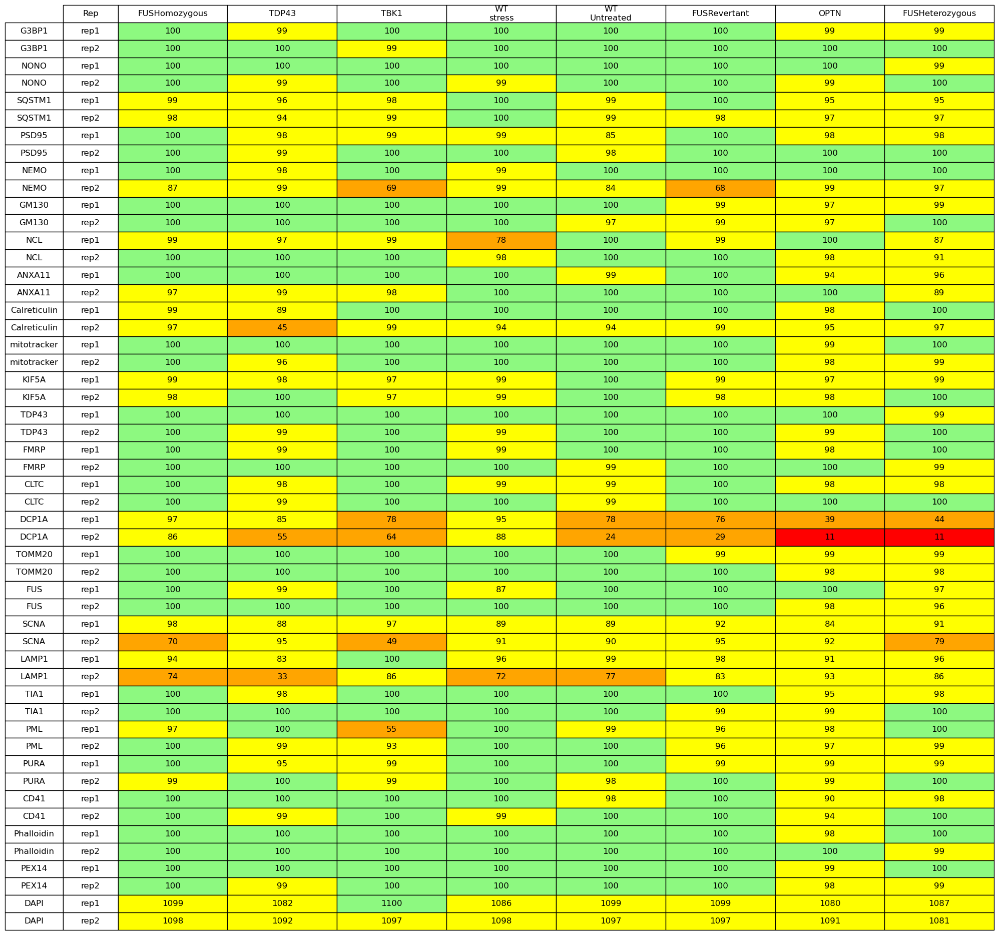

batch7
Folder structure is valid.
No bad files are found.
Total Sites:  56071


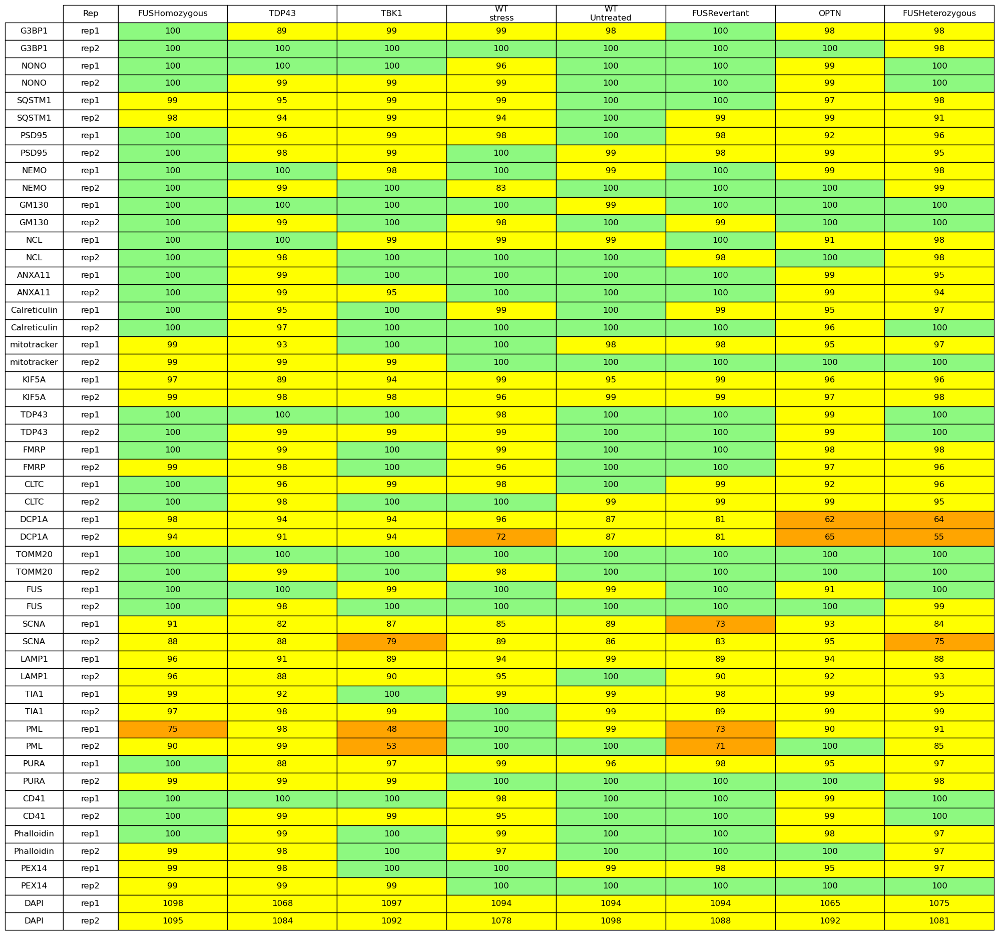

batch8
Folder structure is valid.
No bad files are found.
Total Sites:  55505


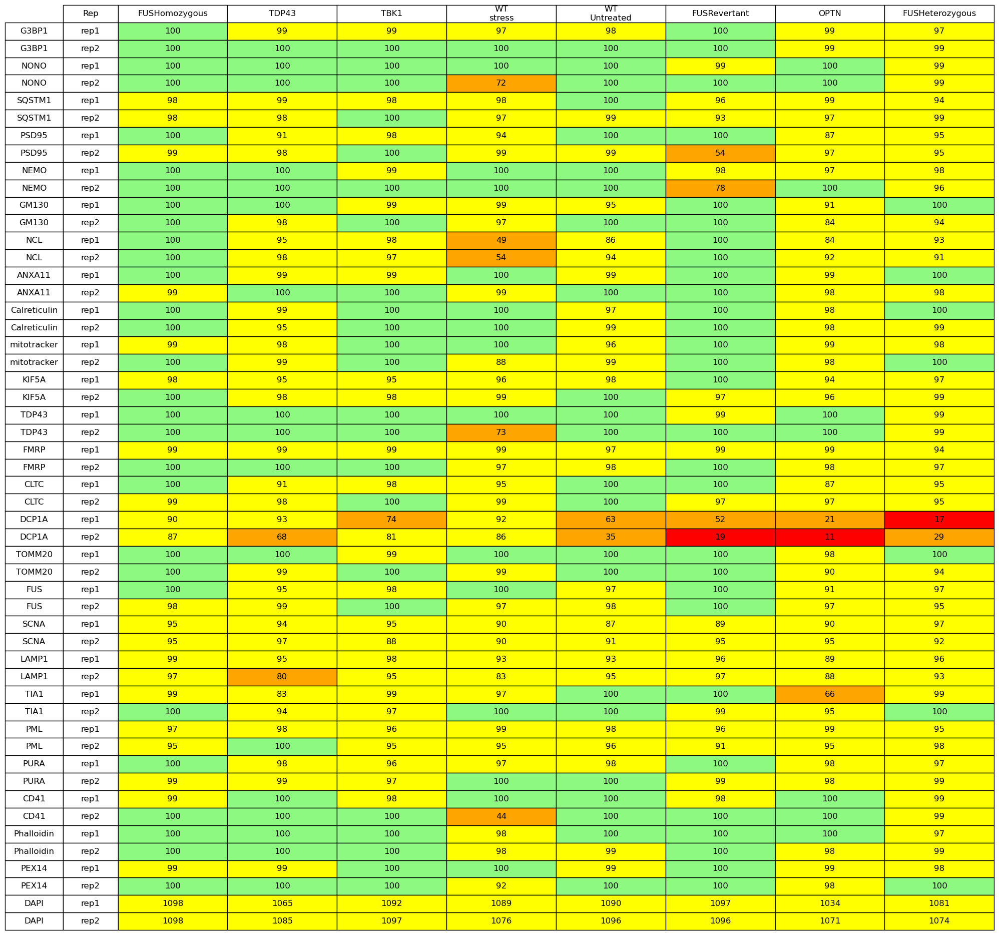

batch9
Folder structure is valid.
No bad files are found.
Total Sites:  55574


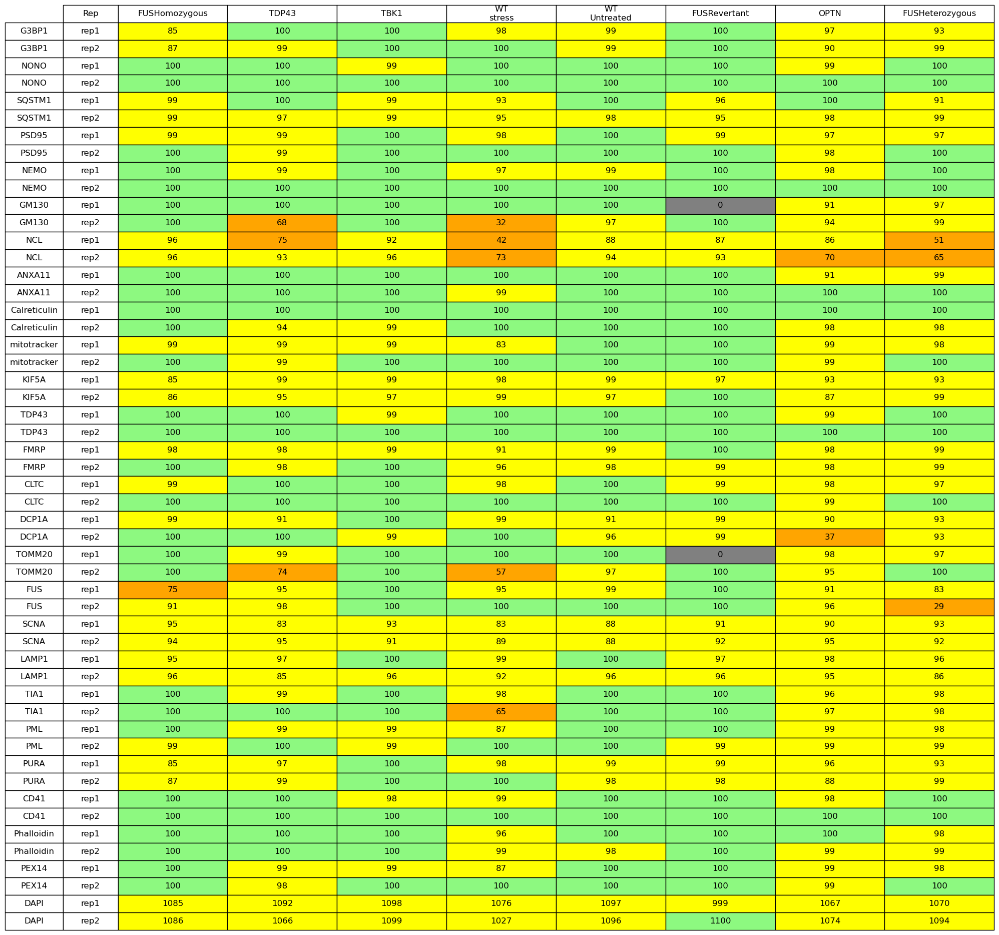

In [14]:
root_directory_proc = os.path.join(NOVA_DATA_HOME, 'input', 'images', 'processed', 'spd2',
                              'SpinningDisk')
procs = run_validate_folder_structure(root_directory_proc, True, panels, markers,PLOT_PATH,marker_info,
                                    cell_lines_to_cond, reps, cell_lines_for_disp, expected_dapi_raw,
                                     batches=batches)

### Difference between Raw and Processed

batch3


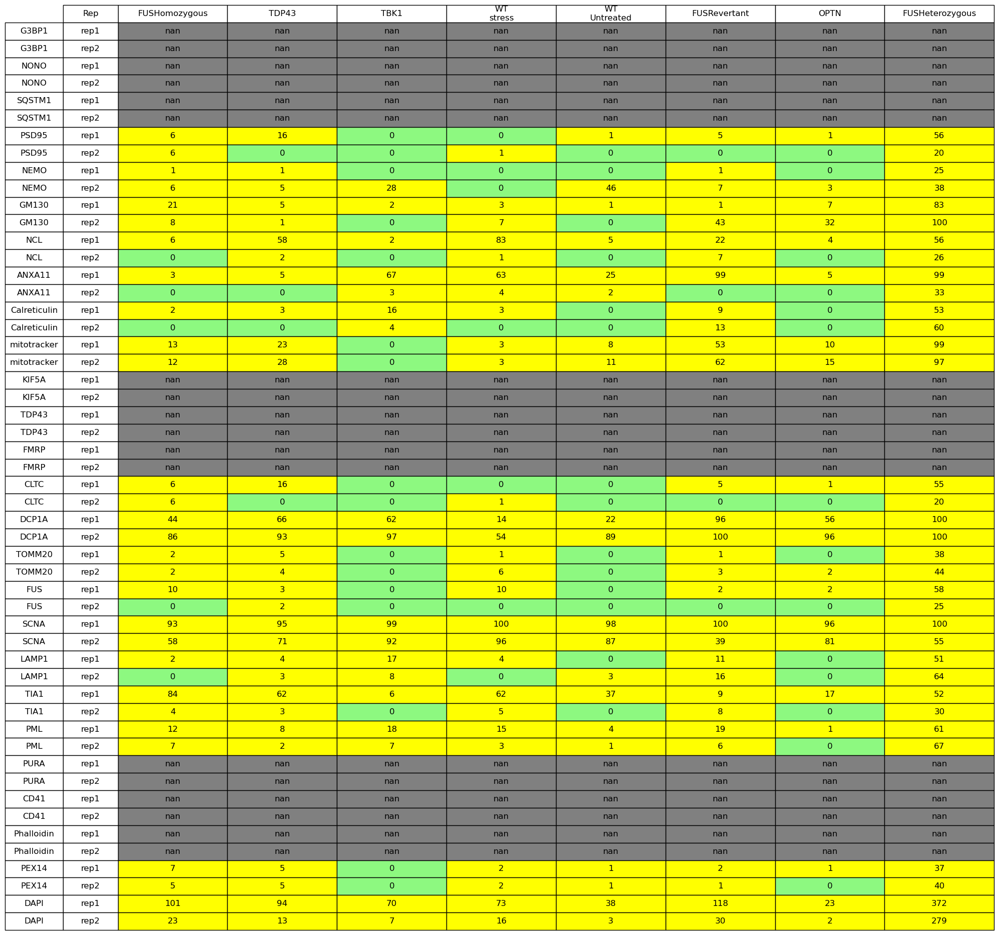

batch4


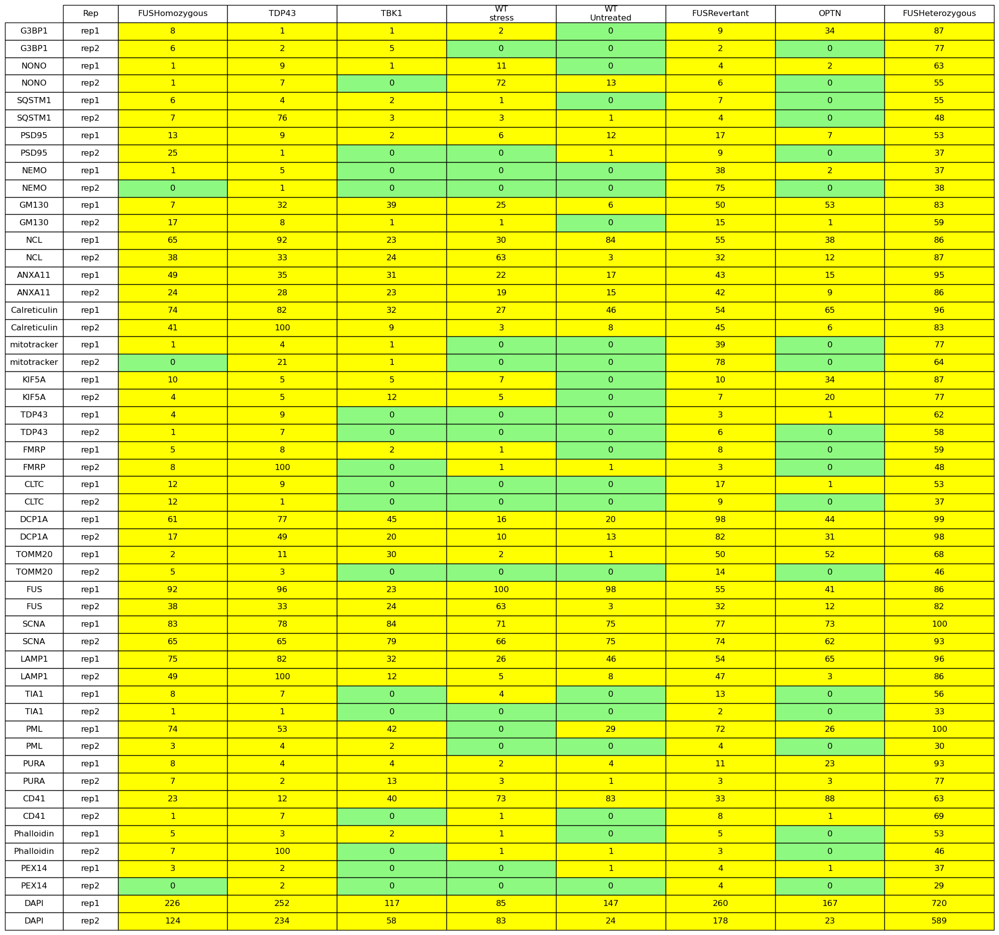

batch5


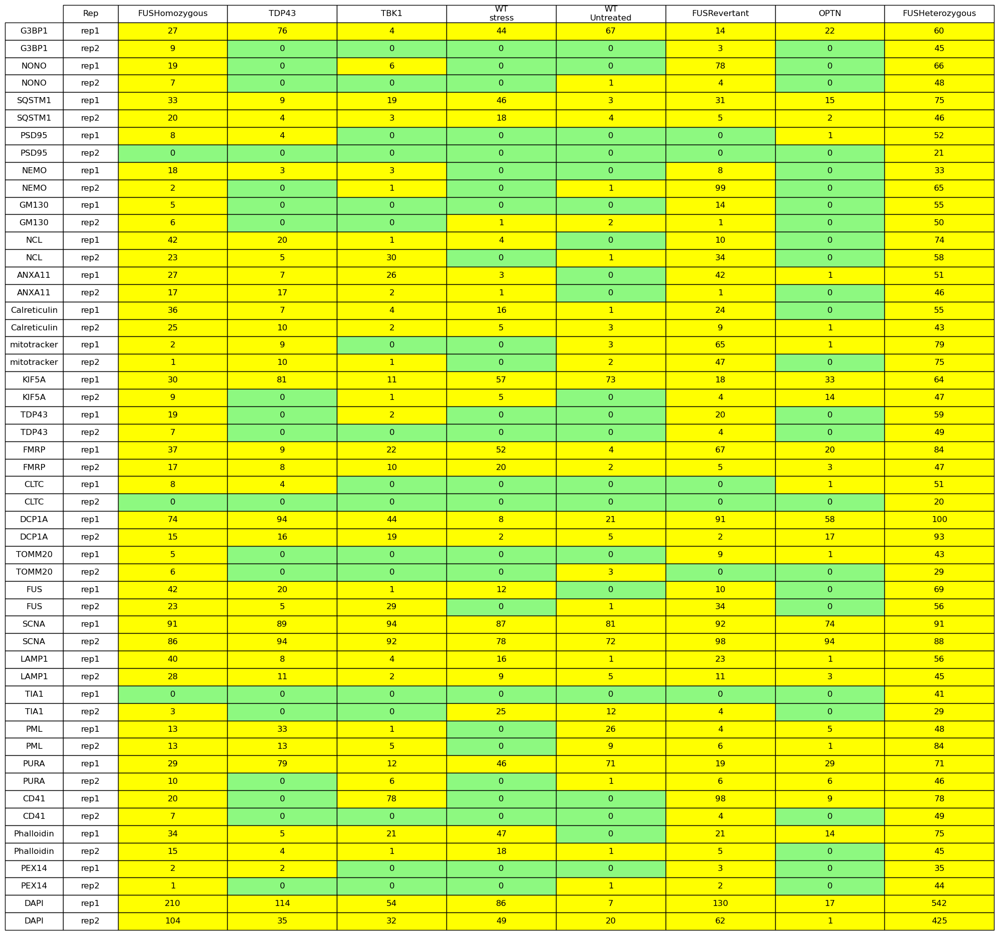

batch6


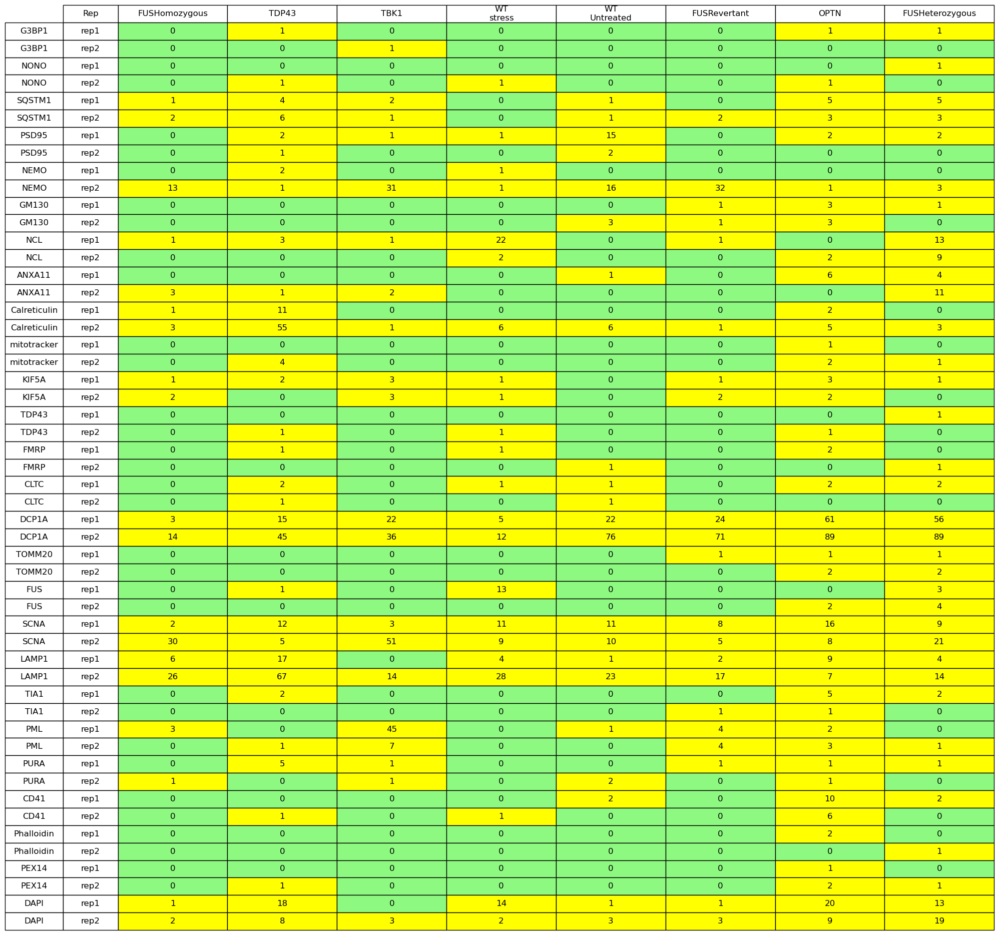

batch7


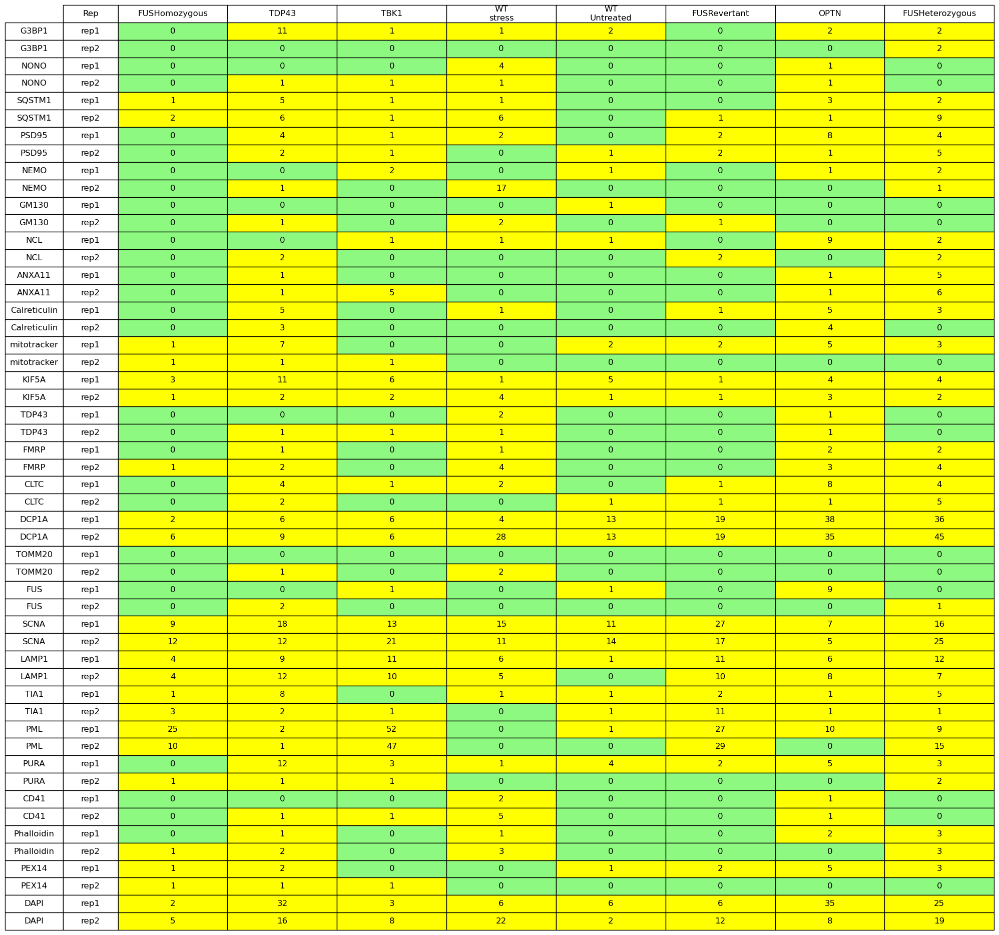

batch8


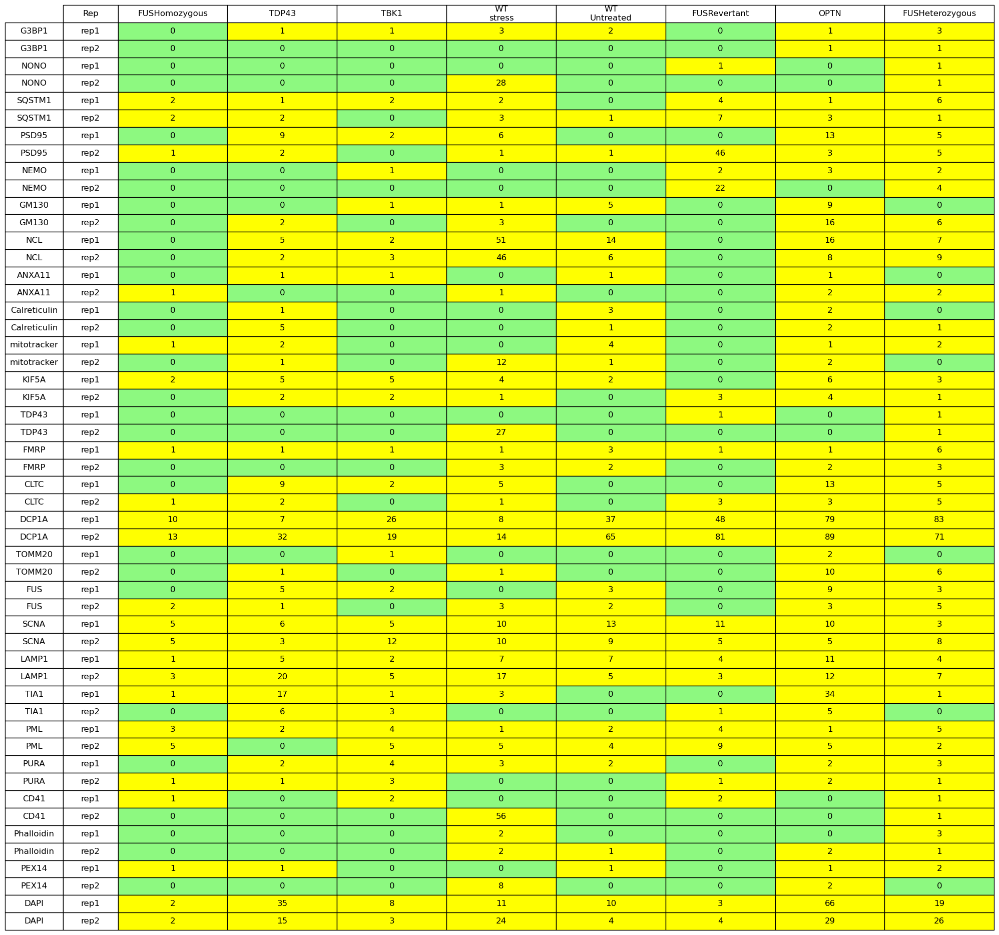

batch9


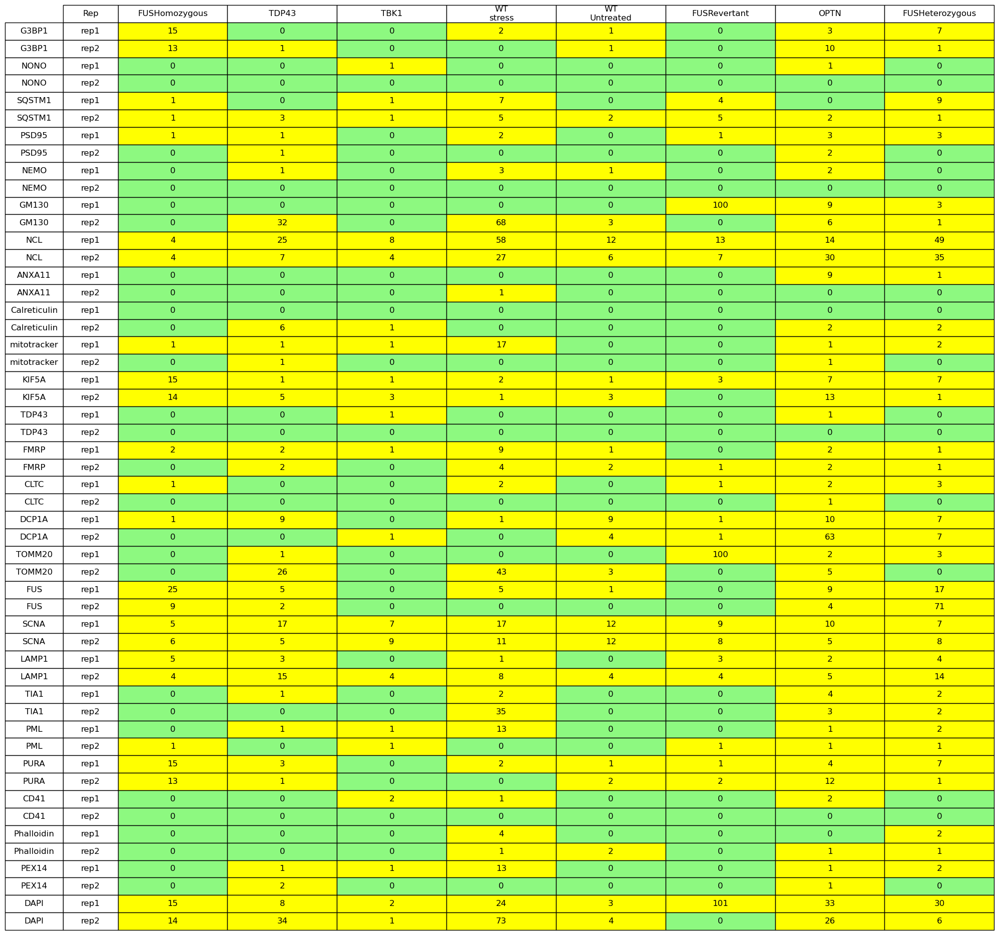

In [15]:
display_diff(batches, raws, procs, PLOT_PATH)

### Variance in each batch (of processed files)

In [16]:
for batch in batches:
    with contextlib.redirect_stdout(io.StringIO()):
        var = sample_and_calc_variance(root_directory_proc, batch, 
                                       sample_size_per_markers=200, num_markers=26)
    print(f'{batch} var: ',var)

batch3 var:  0.015775882837084462
batch4 var:  0.014266254500867513
batch5 var:  0.015126299969755048
batch6 var:  0.016459885038877964
batch7 var:  0.01608249615403339
batch8 var:  0.01643550375364174
batch9 var:  0.016846129673614187


## Preprocessing Filtering qc
By order of filtering

### 1. % site survival after Brenner on DAPI channel
Percentage out of the total sites

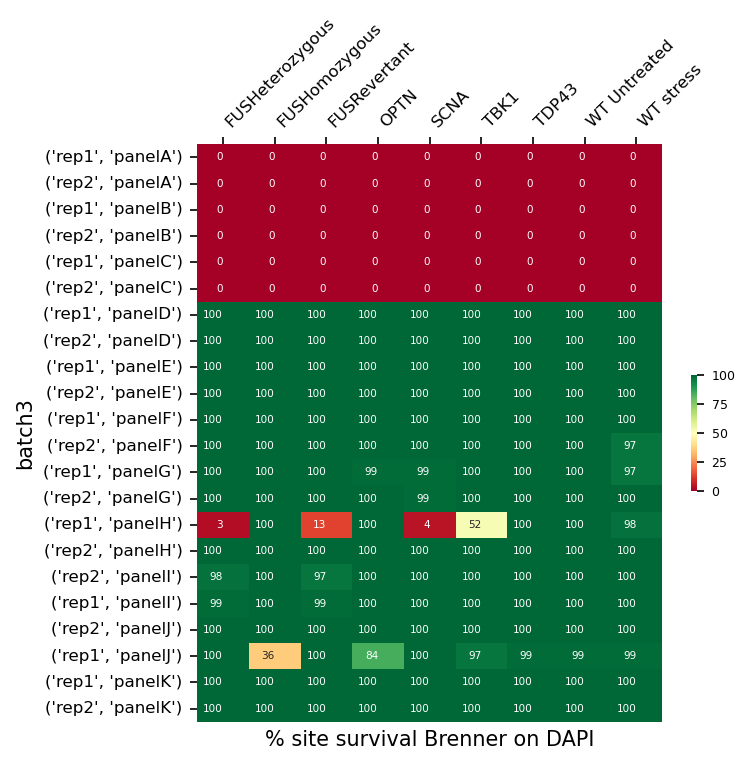

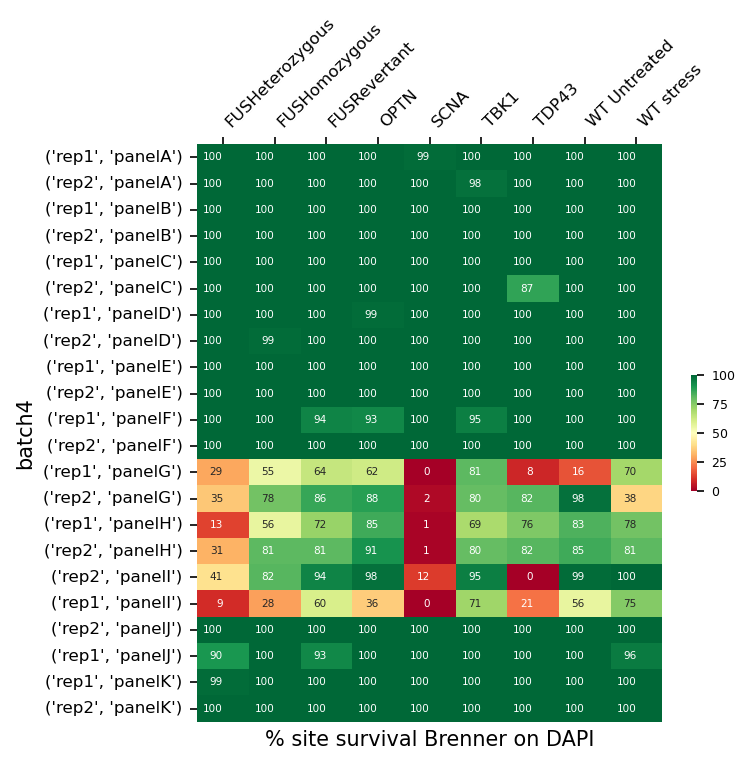

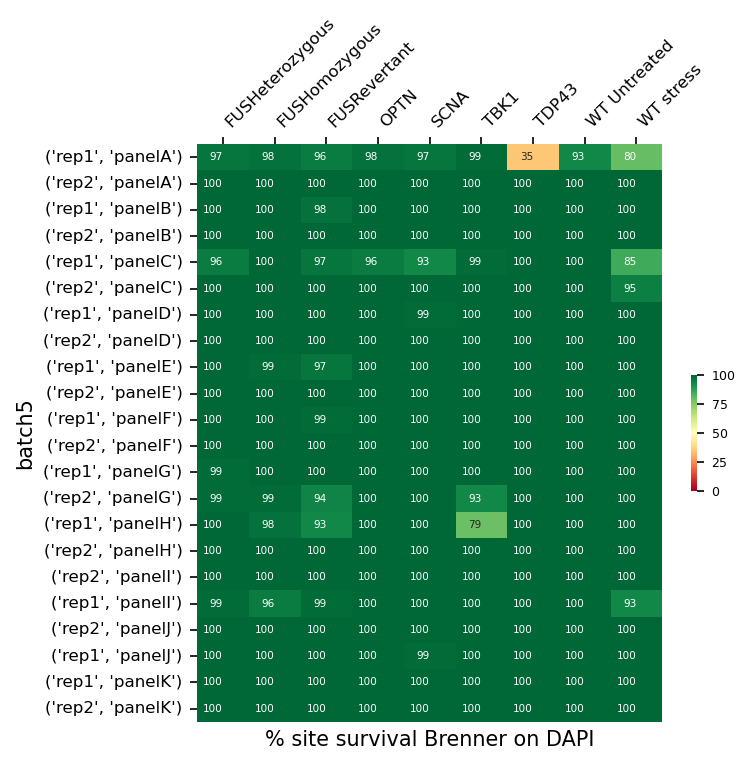

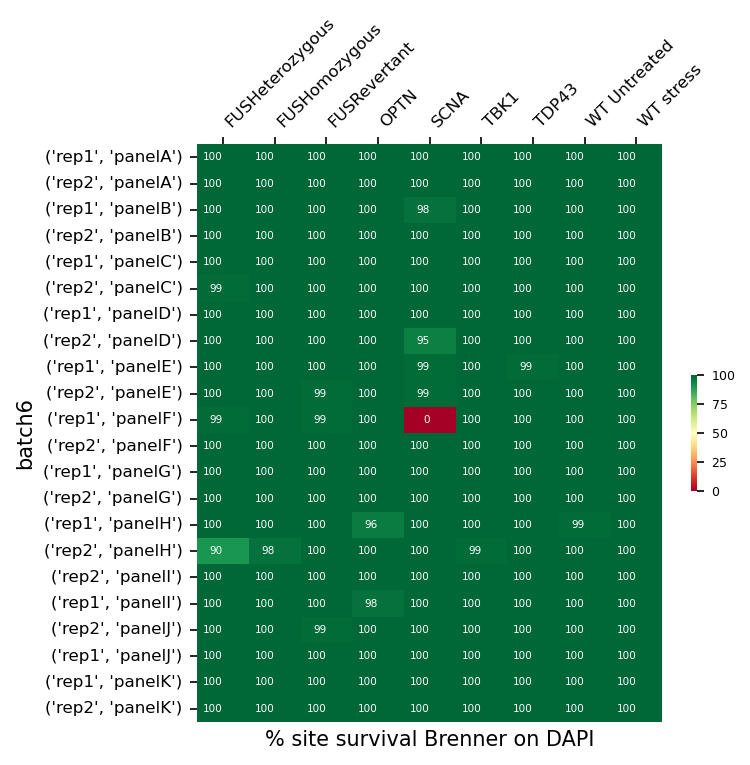

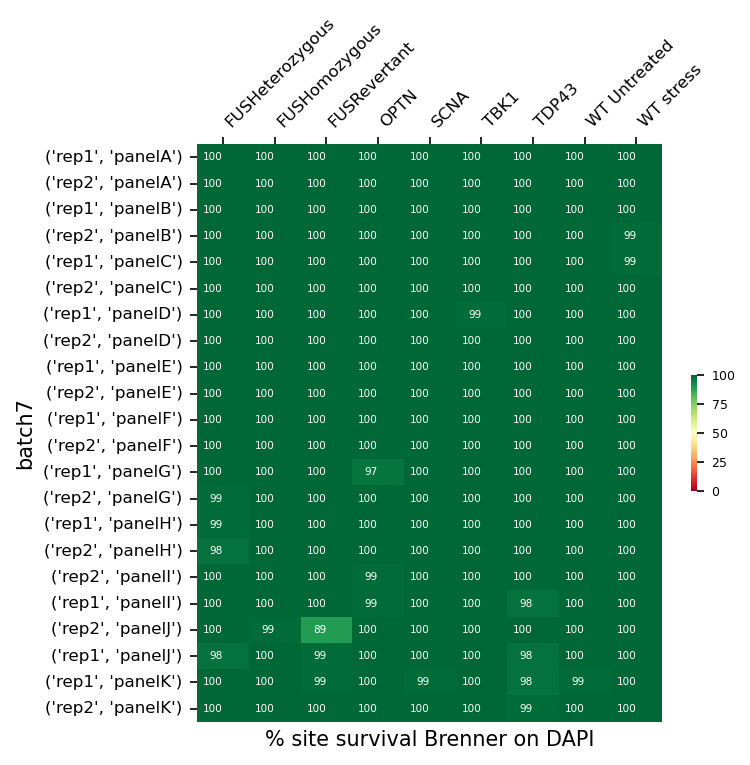

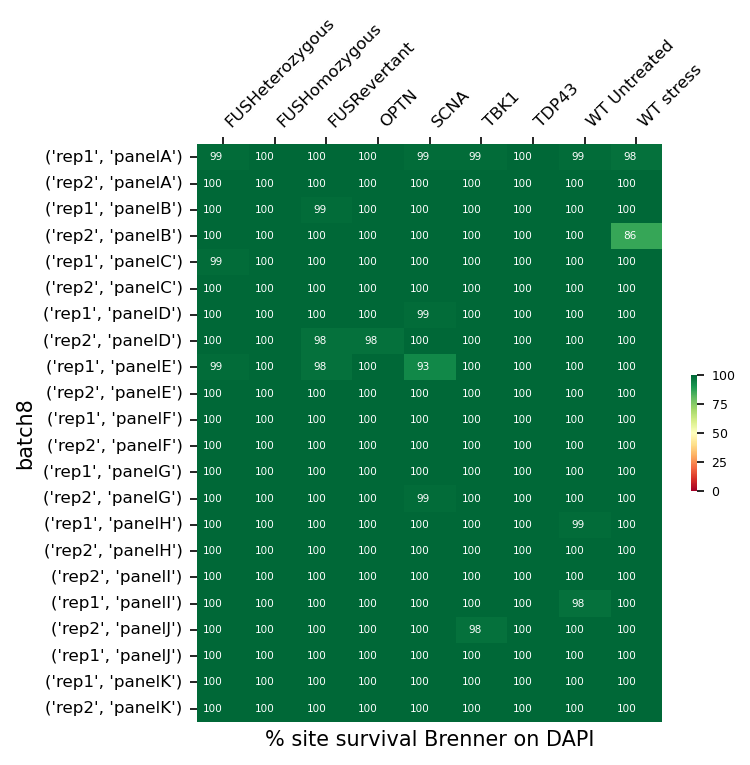

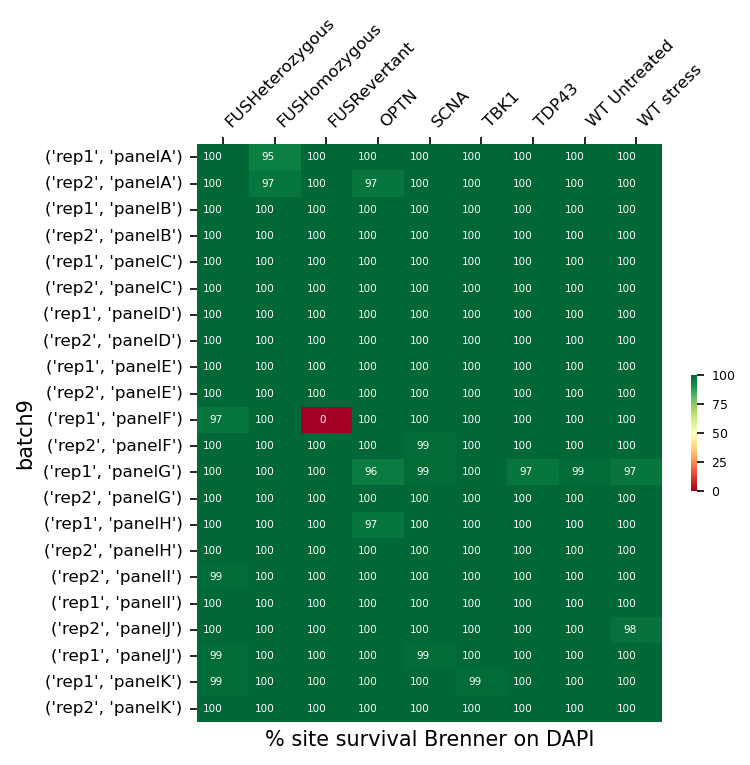

In [17]:
dapi_filter_by_brenner = show_site_survival_dapi_brenner(df_dapi,batches, line_colors, panels, reps)

### 2. % Site survival after Cellpose
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values.

**A site will be filtered out if Cellpose found 0 cells in it.**

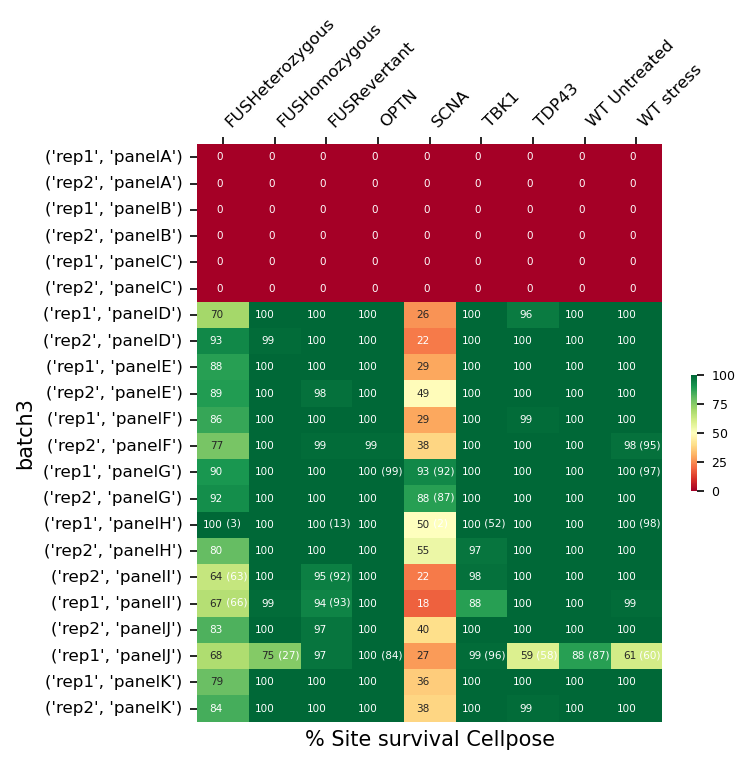

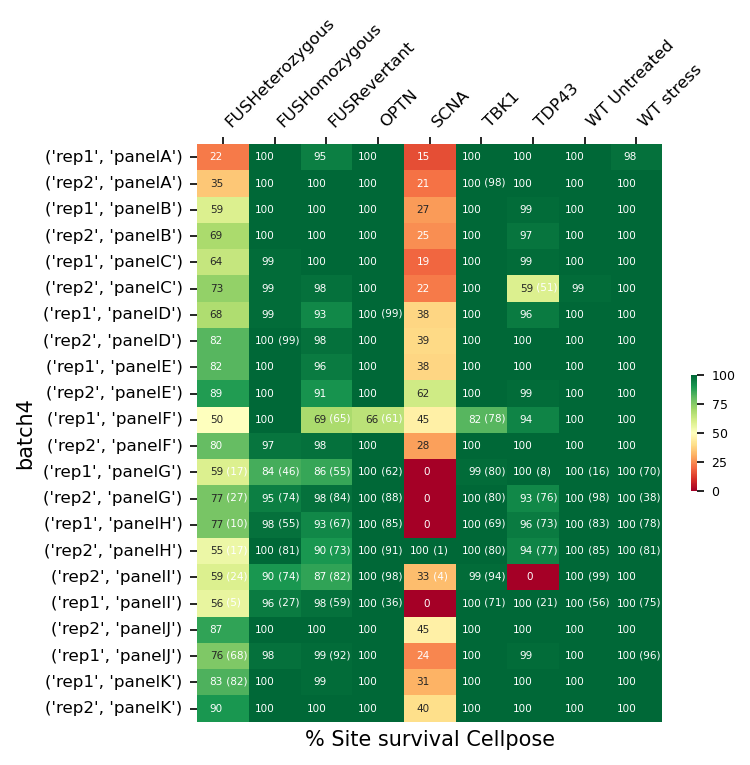

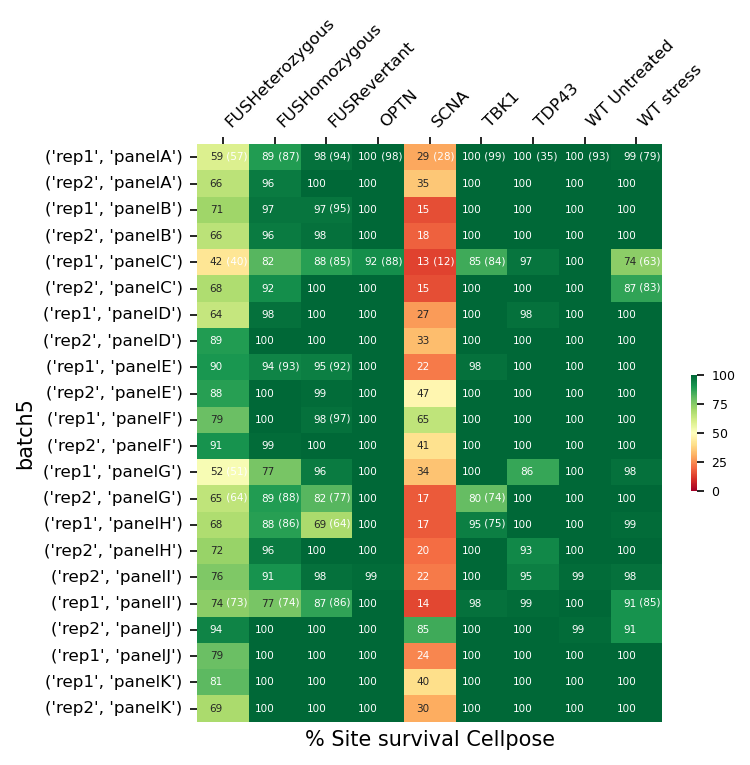

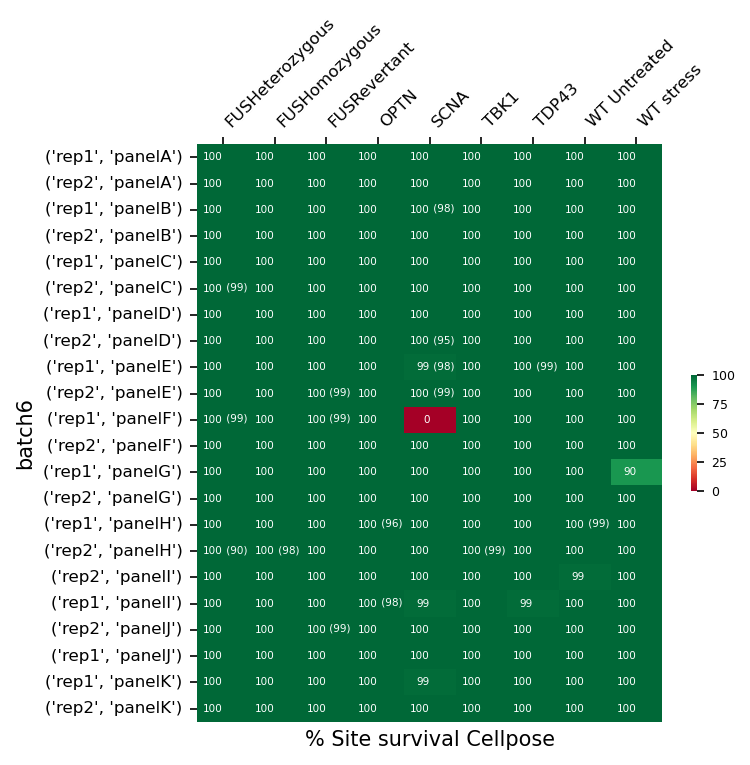

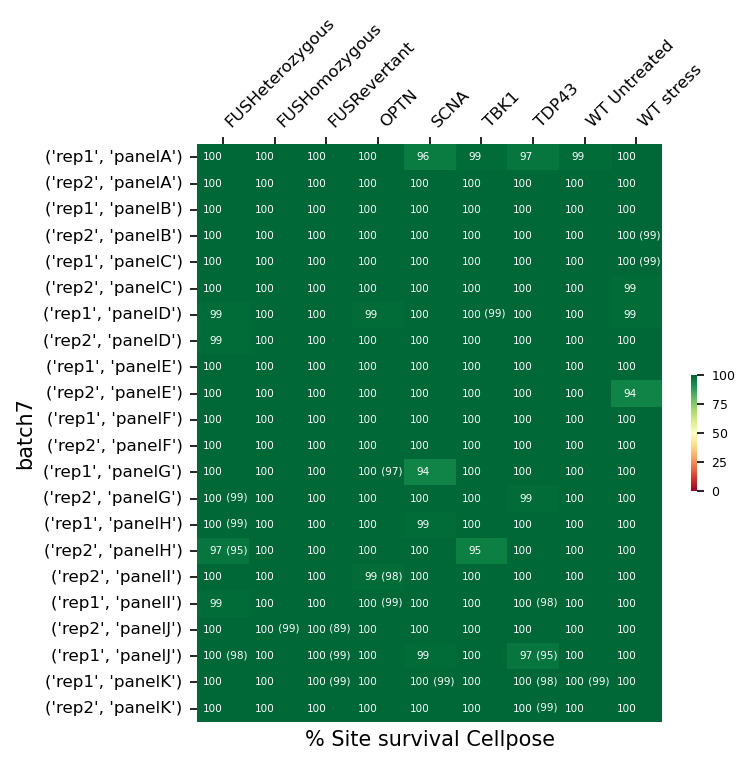

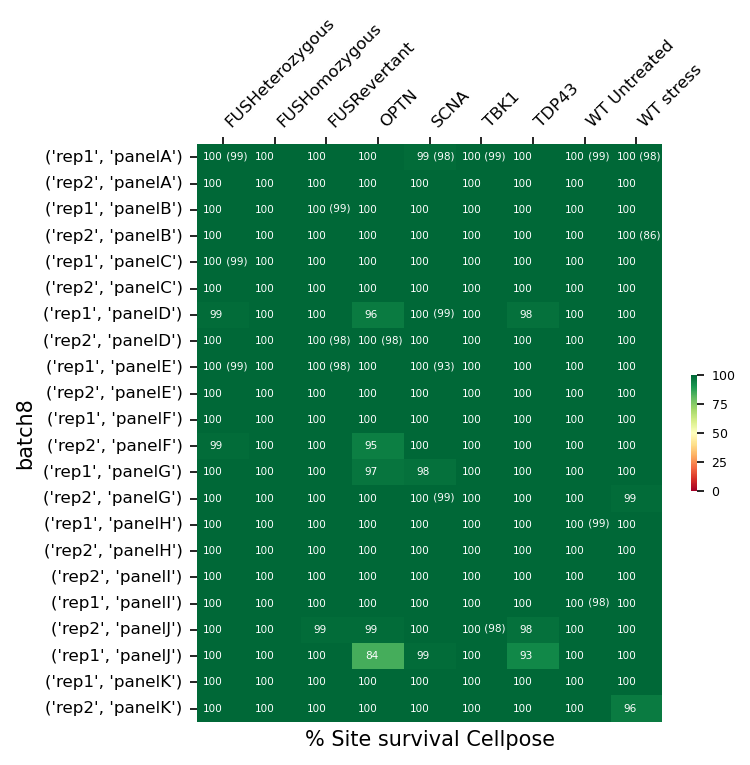

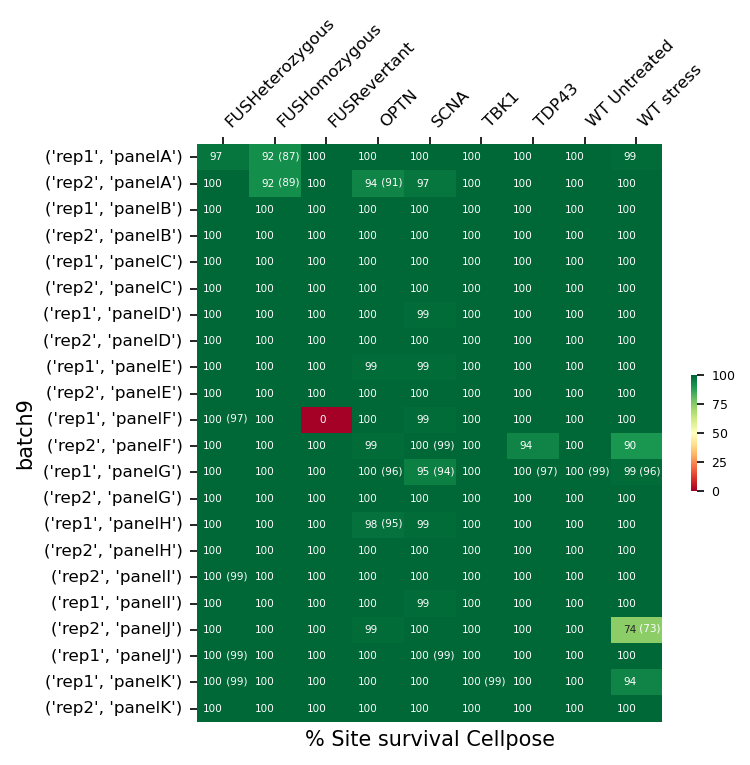

In [21]:
dapi_filter_by_cellpose = show_site_survival_dapi_cellpose(df_dapi, batches, dapi_filter_by_brenner, line_colors, panels, reps)

### 3. % Site survival by tiling
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values.

**A site will be filtered out if after tiling, no tile is containing at least one whole cell that Cellpose detected.**

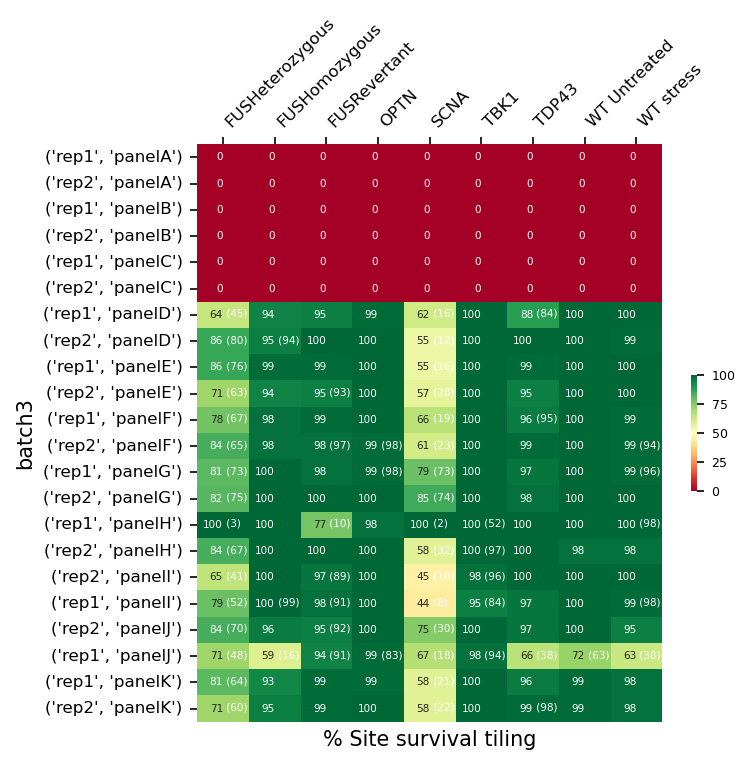

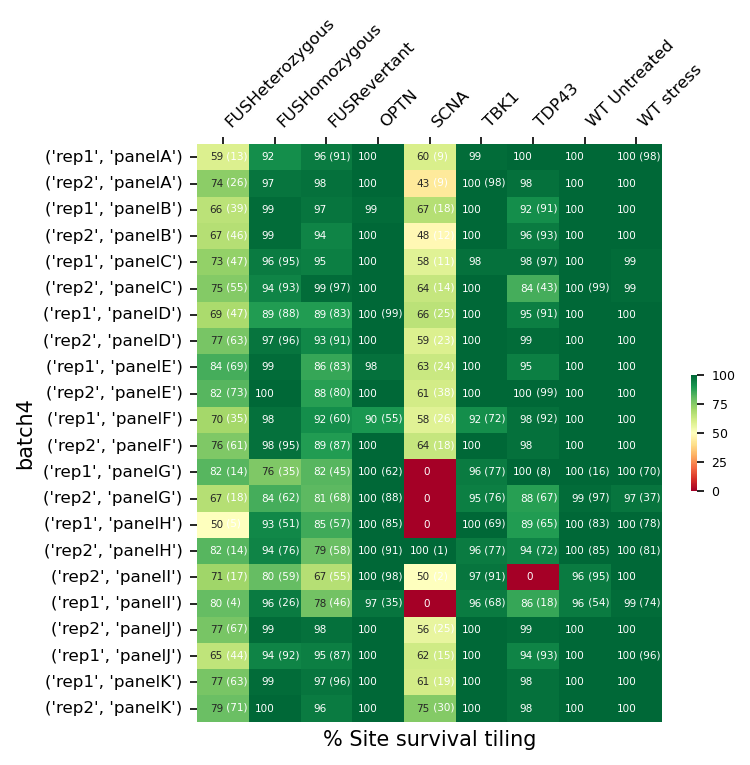

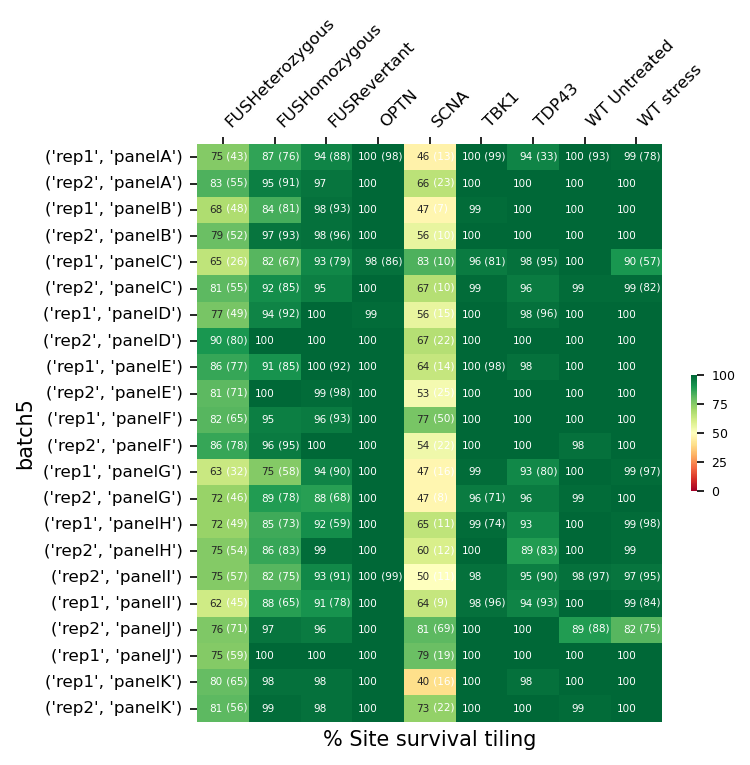

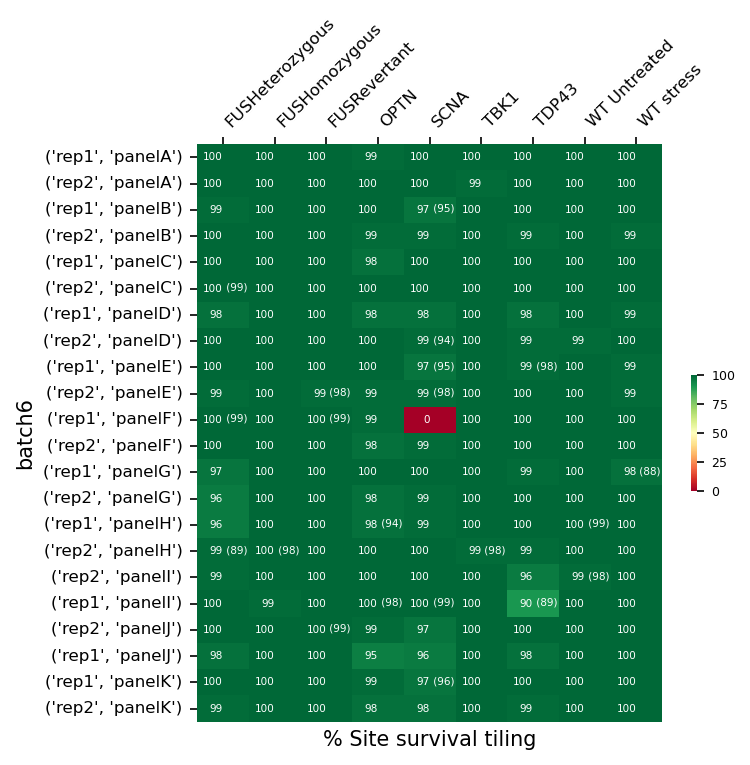

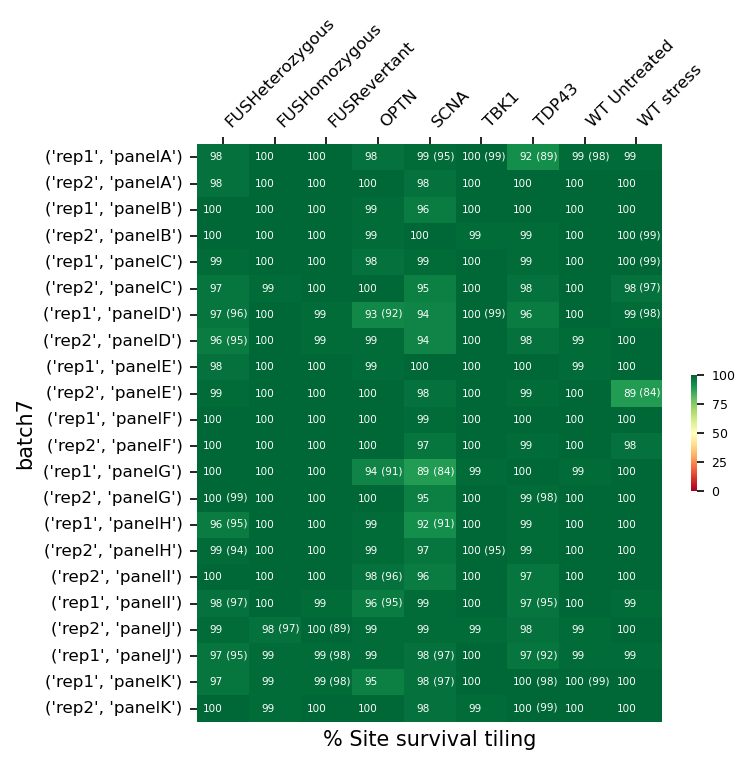

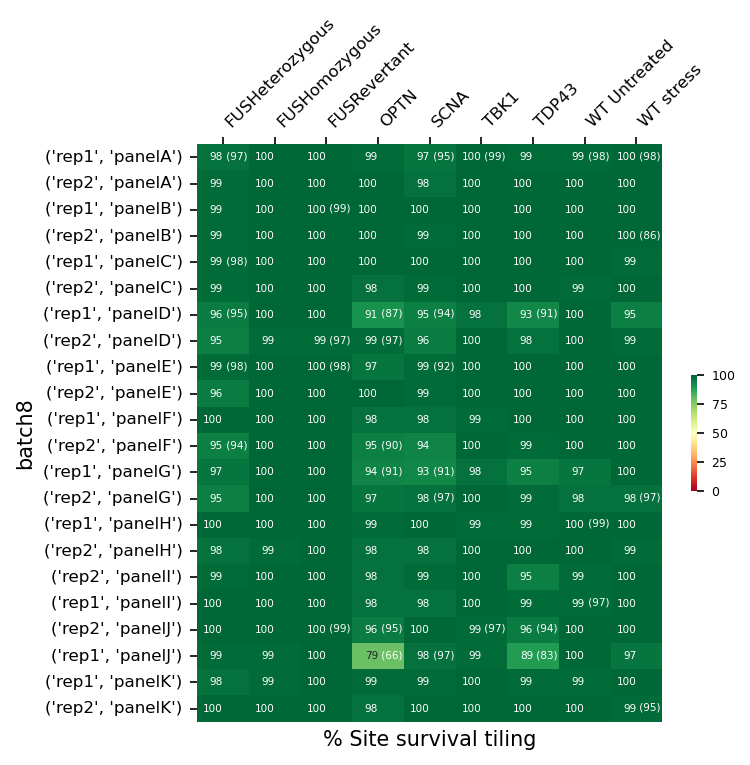

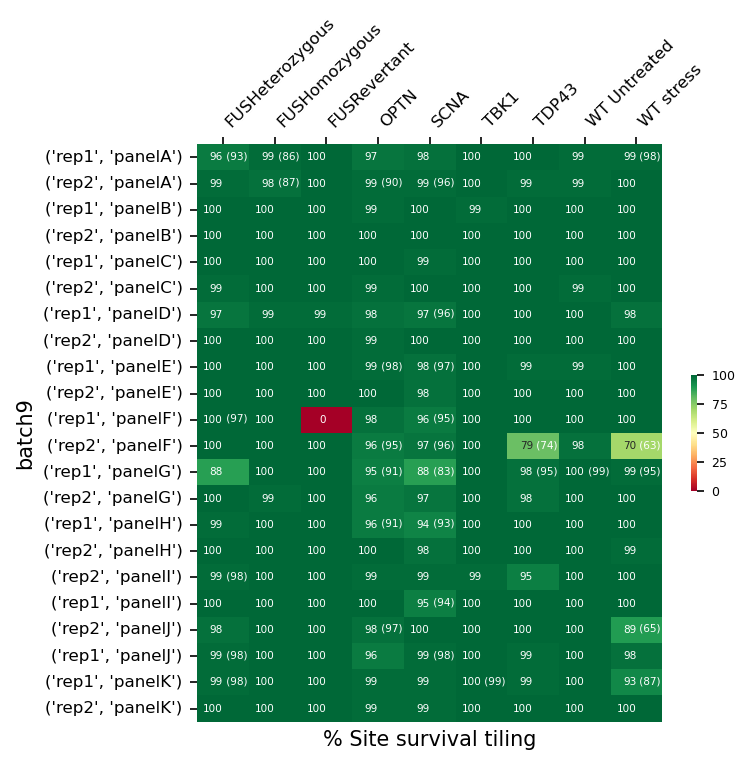

In [22]:
dapi_filter_by_tiling=show_site_survival_dapi_tiling(df_dapi, batches, dapi_filter_by_cellpose, line_colors, panels, reps)

### 4. % Site survival after Brenner on target channel
Percentage out of the sites that passed the previous filter. In parenthesis are absolute values (if different than the percentages).

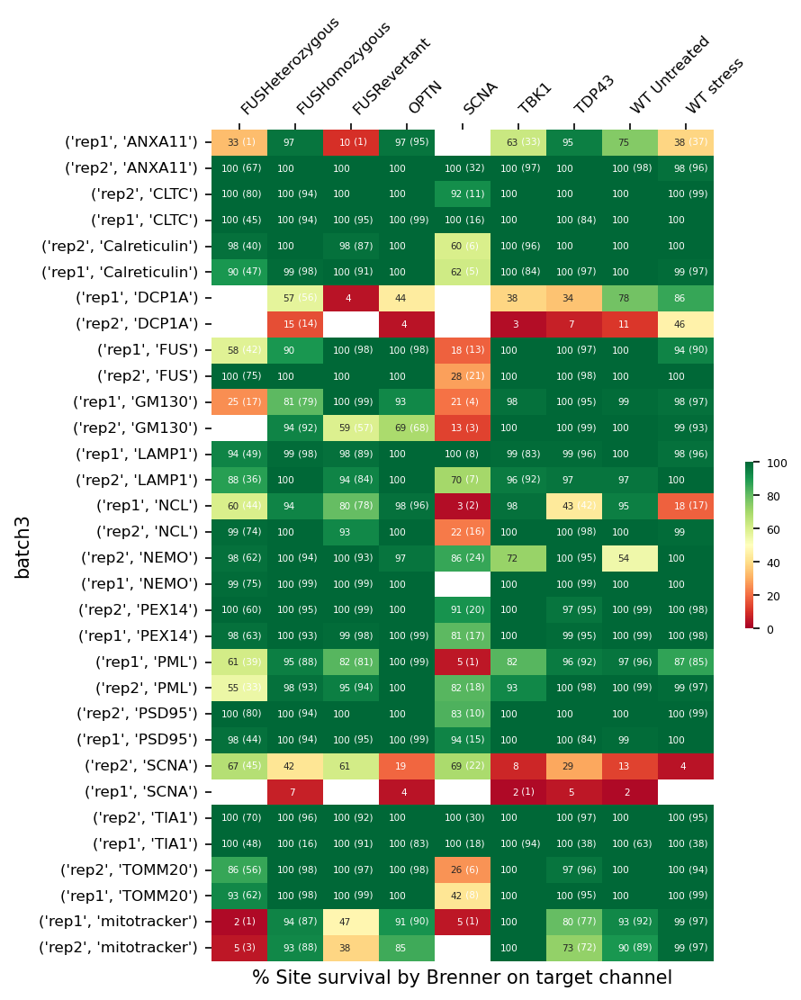

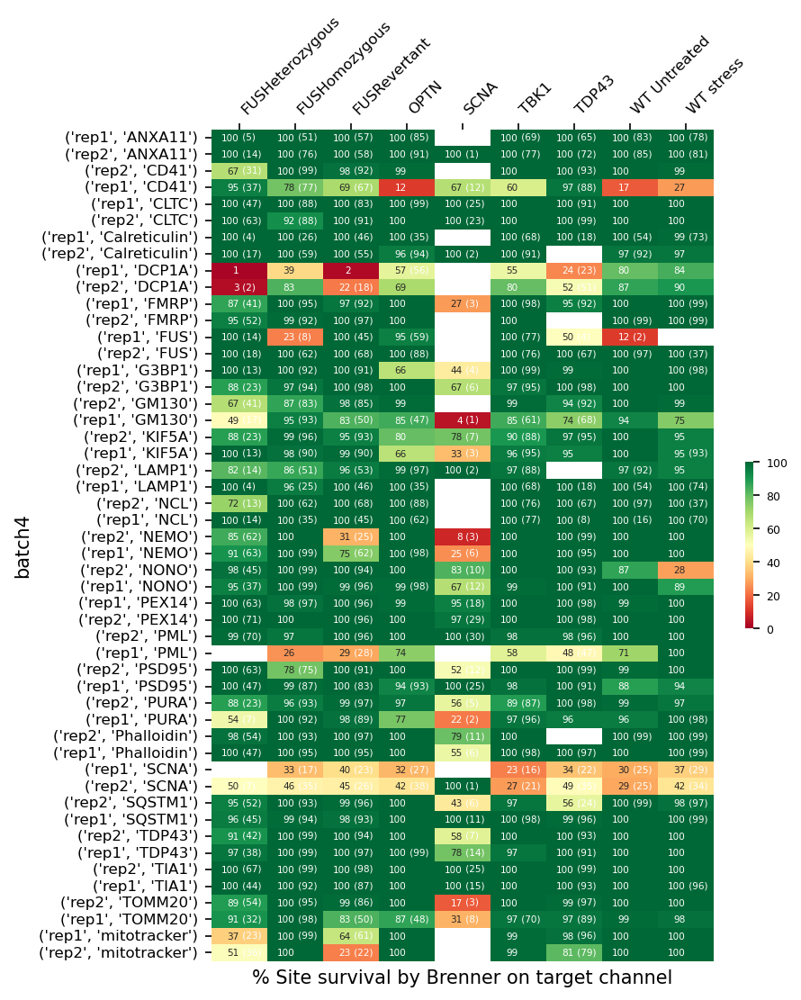

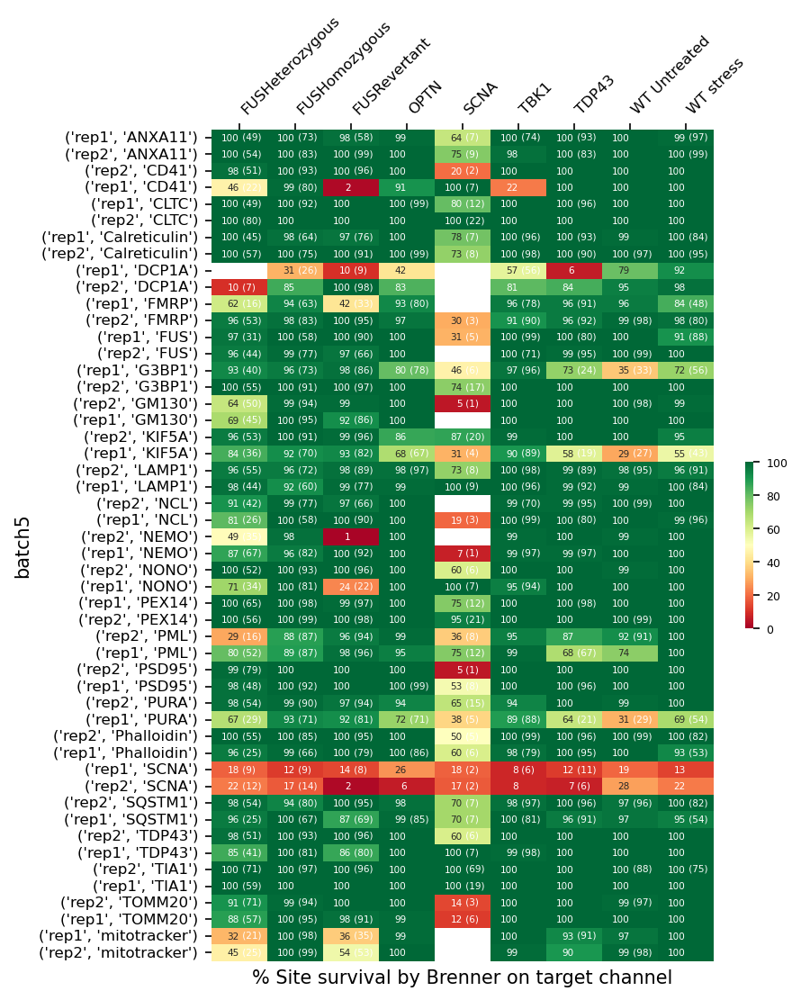

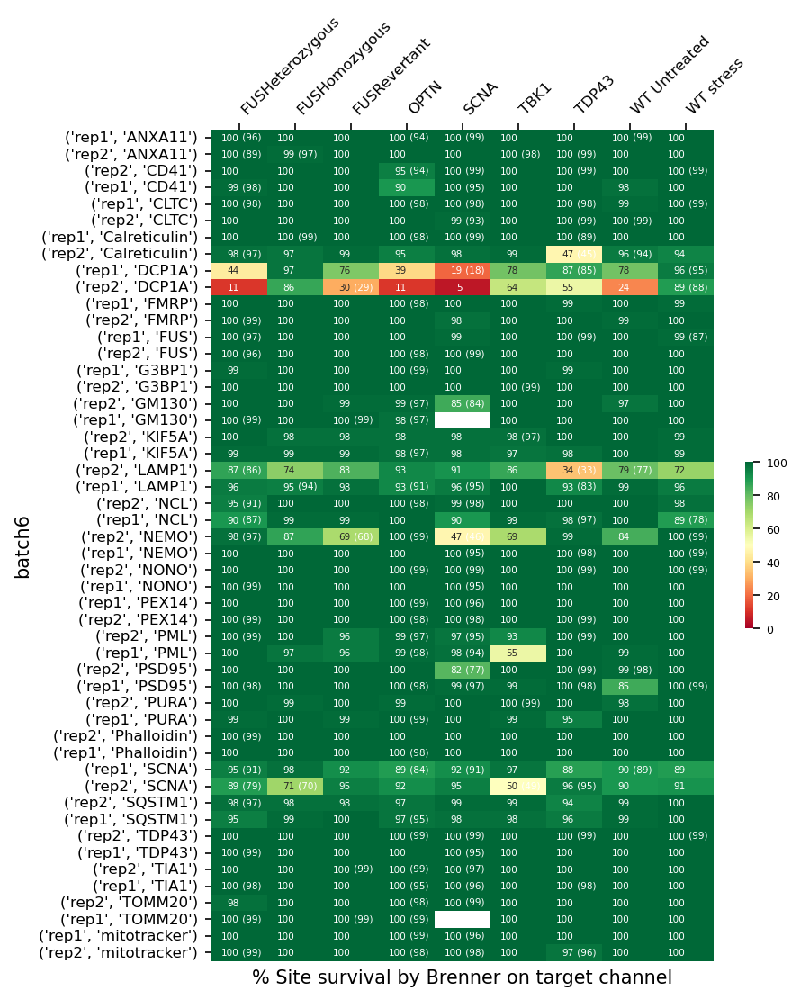

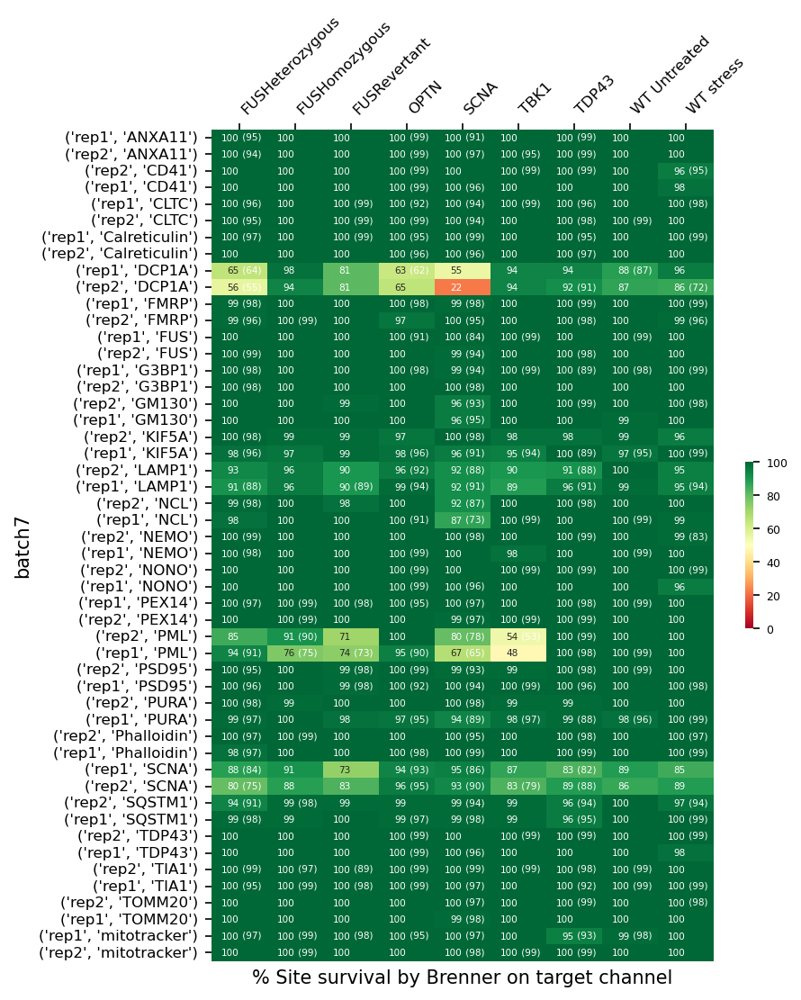

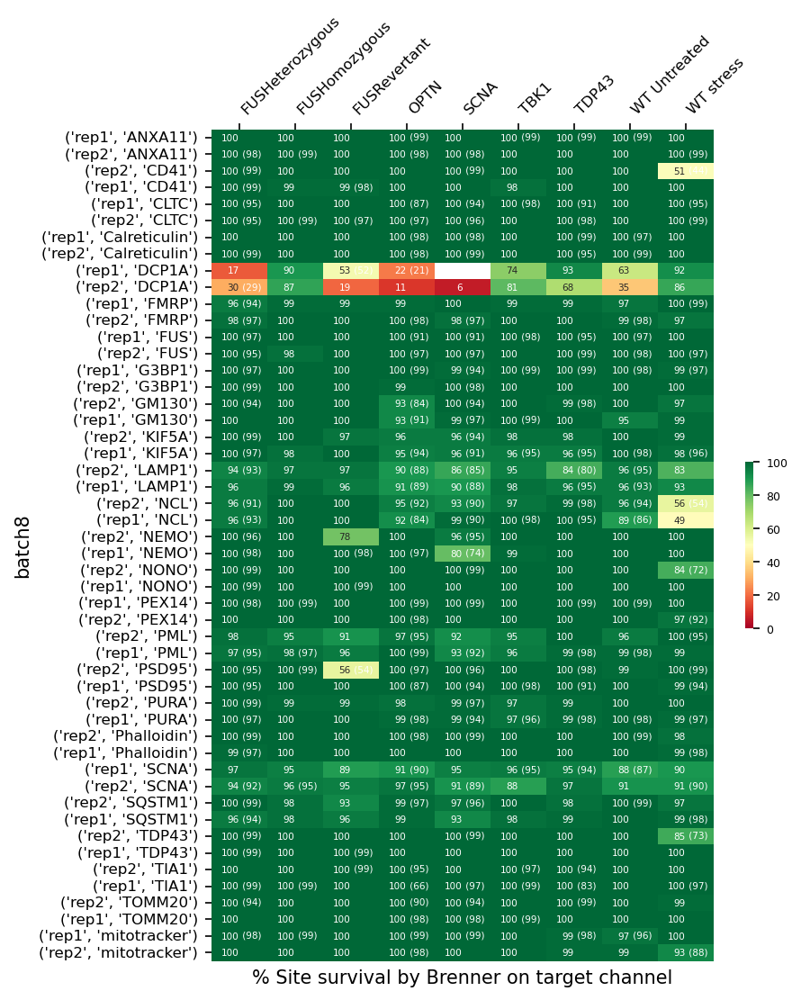

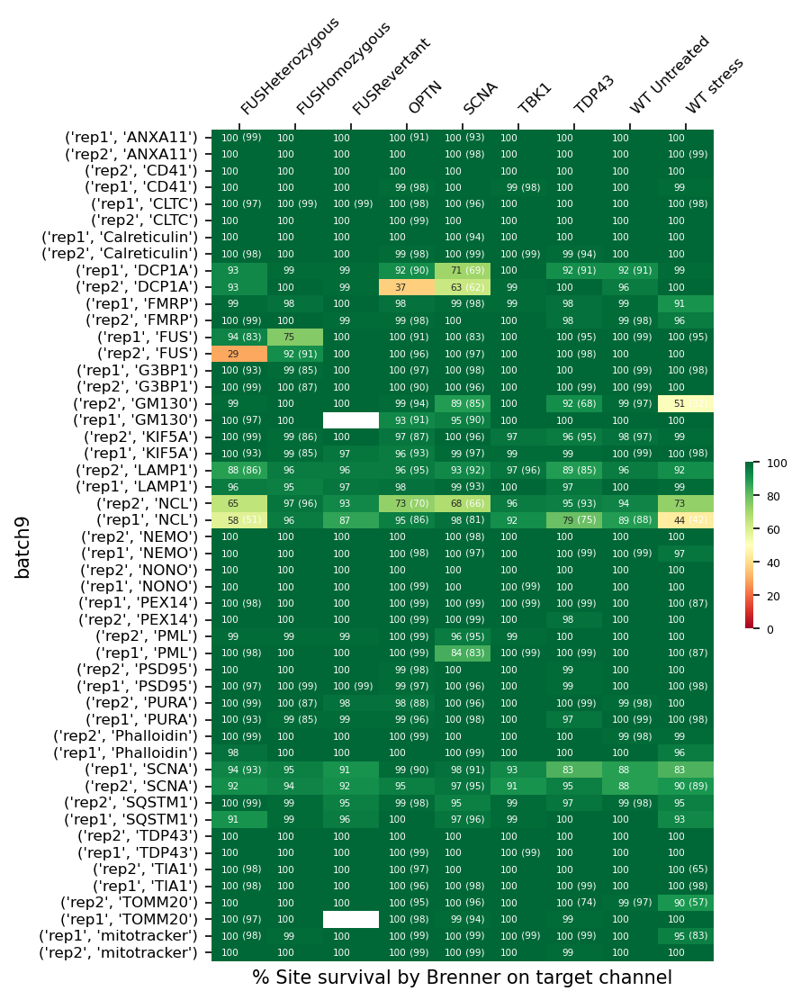

In [23]:
show_site_survival_target_brenner(df_dapi, df_target, dapi_filter_by_tiling, markers)

## Statistics About the Processed Files

In [54]:
names = ['Total number of tiles', 'Total number of whole cells']
stats = ['n_valid_tiles','site_whole_cells_counts_sum','site_cell_count','site_cell_count_sum']
total_sum = calc_total_sums(df_target, df_dapi, stats, markers)

### Total tiles

In [65]:
## Are we using FMRP? and batch3-5?
total_sum[(total_sum.batch.str.contains('6|7|8|9', regex=True)) 
          & (~total_sum.marker.str.contains('TIA|DAPI', regex=True))].n_valid_tiles.sum()

1164303

### Total Dapi tiles


In [68]:
total_sum[(total_sum.batch.str.contains('6|7|8|9', regex=True)) 
          & (total_sum.marker == 'DAPI')].n_valid_tiles.sum()

536624

### Total neurons

In [67]:
total_sum[(total_sum.batch.str.contains('6|7|8|9', regex=True)) 
          & (~total_sum.marker.str.contains('TIA|DAPI', regex=True))].site_cell_count_sum.sum()

5236032.0

### Total Dapi neurons

In [69]:
total_sum[(total_sum.batch.str.contains('6|7|8|9', regex=True)) 
          & (total_sum.marker == 'DAPI')].site_cell_count_sum.sum()

2388700.0

<Axes: >

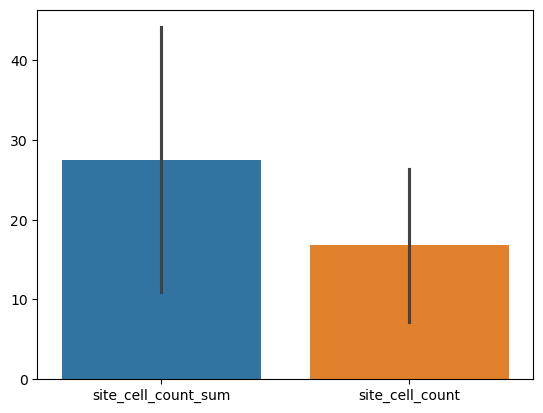

In [61]:
import seaborn as sns
sns.barplot(df_dapi[['site_cell_count_sum','site_cell_count']], errorbar='sd')

### Total tiles in training batches

In [63]:
total_sum[(total_sum.batch.str.contains('7|8', regex=True)) & (~total_sum.marker.str.contains('TIA|DAPI', regex=True))].n_valid_tiles.sum()

562704

### Total neurons in training batches

In [66]:
total_sum[(total_sum.batch.str.contains('7|8', regex=True)) 
          & (~total_sum.marker.str.contains('TIA|DAPI', regex=True))].site_cell_count_sum.sum()

2431381.0

In [27]:
show_total_sum_tables(total_sum)

,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch3,,,,
count,275.000000,275.000000,275.000000,275.000000
mean,491.050909,4.910509,529.781818,1386.040000
std,325.938495,3.259385,355.777512,940.874586
min,1.000000,0.010000,1.000000,1.000000
25%,161.000000,1.610000,170.000000,393.500000
50%,508.000000,5.080000,542.000000,1443.000000
75%,766.500000,7.665000,827.500000,2148.000000
max,1176.000000,11.760000,1306.000000,3471.000000
sum,135039.000000,NaN,145690.000000,381161.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch4,,,,
count,427.000000,427.000000,427.000000,427.000000
mean,474.637002,4.746370,515.152225,1190.470726
std,348.904606,3.489046,385.252186,906.871986
min,1.000000,0.010000,1.000000,1.000000
25%,137.500000,1.375000,142.000000,319.500000
50%,450.000000,4.500000,483.000000,1119.000000
75%,810.000000,8.100000,865.000000,1980.000000
max,1158.000000,11.580000,1294.000000,3027.000000
sum,202670.000000,NaN,219970.000000,508331.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch5,,,,
count,440.000000,440.000000,440.000000,440.000000
mean,520.420455,5.204205,567.122727,1318.747727
std,354.401646,3.544016,391.108918,930.812043
min,1.000000,0.010000,1.000000,1.000000
25%,185.750000,1.857500,195.750000,406.250000
50%,546.500000,5.465000,587.000000,1404.500000
75%,812.000000,8.120000,896.250000,2076.000000
max,1157.000000,11.570000,1281.000000,2988.000000
sum,228985.000000,NaN,249534.000000,580249.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch6,,,,
count,448.000000,448.000000,448.000000,448.000000
mean,691.607143,6.916071,737.243304,1939.928571
std,183.055283,1.830553,199.051456,542.722484
min,34.000000,0.340000,36.000000,84.000000
25%,574.000000,5.740000,609.000000,1568.250000
50%,701.000000,7.010000,753.000000,1968.500000
75%,806.000000,8.060000,860.500000,2318.000000
max,1095.000000,10.950000,1189.000000,2996.000000
sum,309840.000000,NaN,330285.000000,869088.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch7,,,,
count,450.000000,450.000000,450.000000,450.000000
mean,667.546667,6.675467,711.373333,1733.484444
std,186.849173,1.868492,203.478783,513.995577
min,129.000000,1.290000,138.000000,323.000000
25%,536.000000,5.360000,566.250000,1349.500000
50%,664.500000,6.645000,701.000000,1756.500000
75%,803.750000,8.037500,853.750000,2128.000000
max,1178.000000,11.780000,1261.000000,3164.000000
sum,300396.000000,NaN,320118.000000,780068.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch8,,,,
count,449.000000,449.000000,449.000000,449.000000
mean,627.512249,6.275122,665.926503,1677.314031
std,176.061996,1.760620,190.137912,507.597138
min,44.000000,0.440000,46.000000,92.000000
25%,516.000000,5.160000,545.000000,1348.000000
50%,620.000000,6.200000,661.000000,1687.000000
75%,743.000000,7.430000,801.000000,2063.000000
max,1086.000000,10.860000,1189.000000,2996.000000
sum,281753.000000,NaN,299001.000000,753114.000000


,n_valid_tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
batch9,,,,
count,448.000000,448.000000,448.000000,448.000000
mean,702.042411,7.020424,749.794643,1930.694196
std,201.269351,2.012694,218.834594,570.274460
min,92.000000,0.920000,97.000000,224.000000
25%,557.750000,5.577500,593.000000,1508.500000
50%,716.000000,7.160000,760.500000,2035.000000
75%,858.000000,8.580000,918.000000,2359.000000
max,1205.000000,12.050000,1323.000000,3215.000000
sum,314515.000000,NaN,335908.000000,864951.000000


,n valid tiles,% valid tiles,site_whole_cells_counts_sum,site_cell_count
All batches,,,,
count,2.937000e+03,2937.000000,2.937000e+03,2.937000e+03
mean,6.037446e+02,6.037446,6.470909e+02,1.612857e+03
std,2.751596e+02,2.751596,2.995121e+02,7.641334e+02
min,1.000000e+00,0.010000,1.000000e+00,1.000000e+00
25%,4.530000e+02,4.530000,4.800000e+02,1.166000e+03
50%,6.280000e+02,6.280000,6.700000e+02,1.672000e+03
75%,7.960000e+02,7.960000,8.550000e+02,2.187000e+03
max,1.205000e+03,12.050000,1.323000e+03,3.471000e+03
sum,1.773198e+06,NaN,1.900506e+06,4.736962e+06


### Show Total Tile Counts
For each batch, cell line, replicate and markerTotal number of tiles

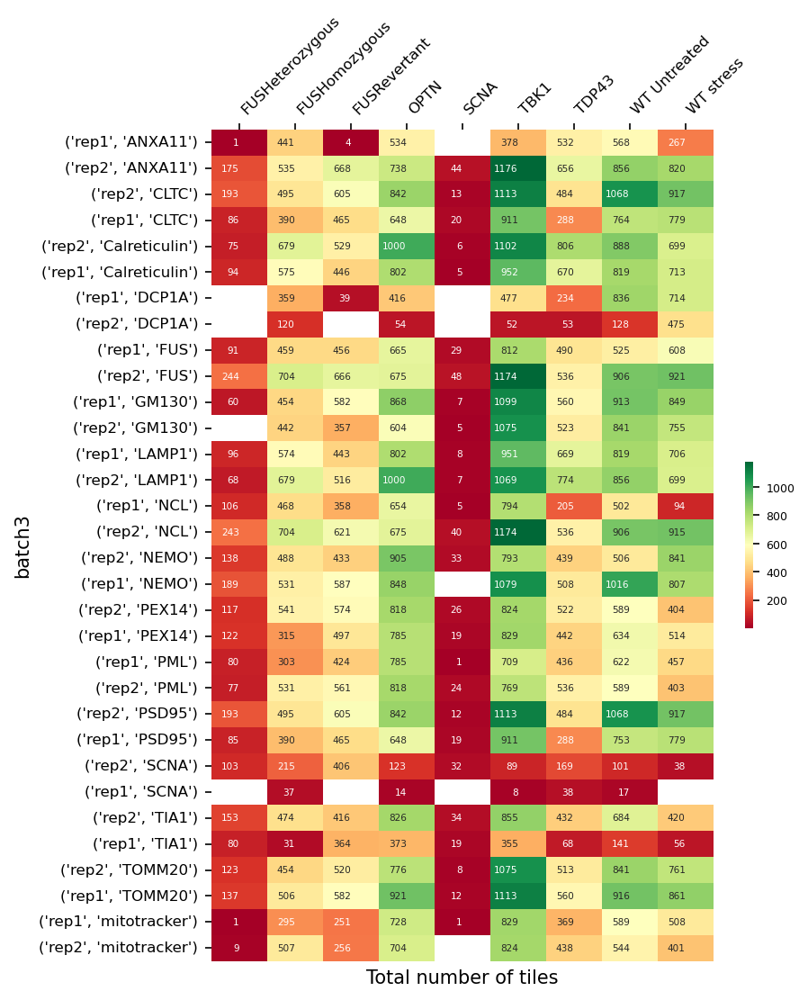

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


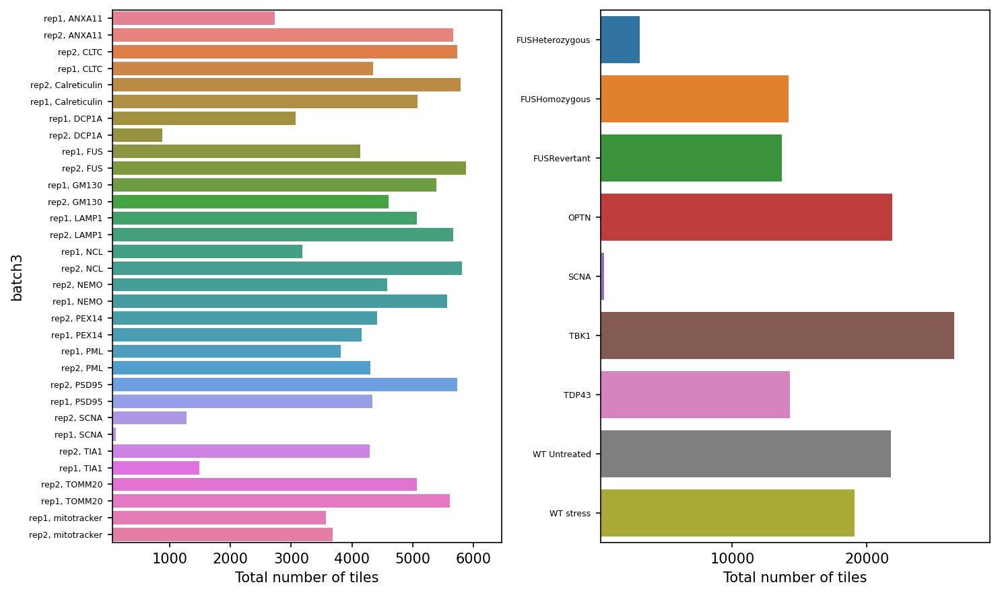

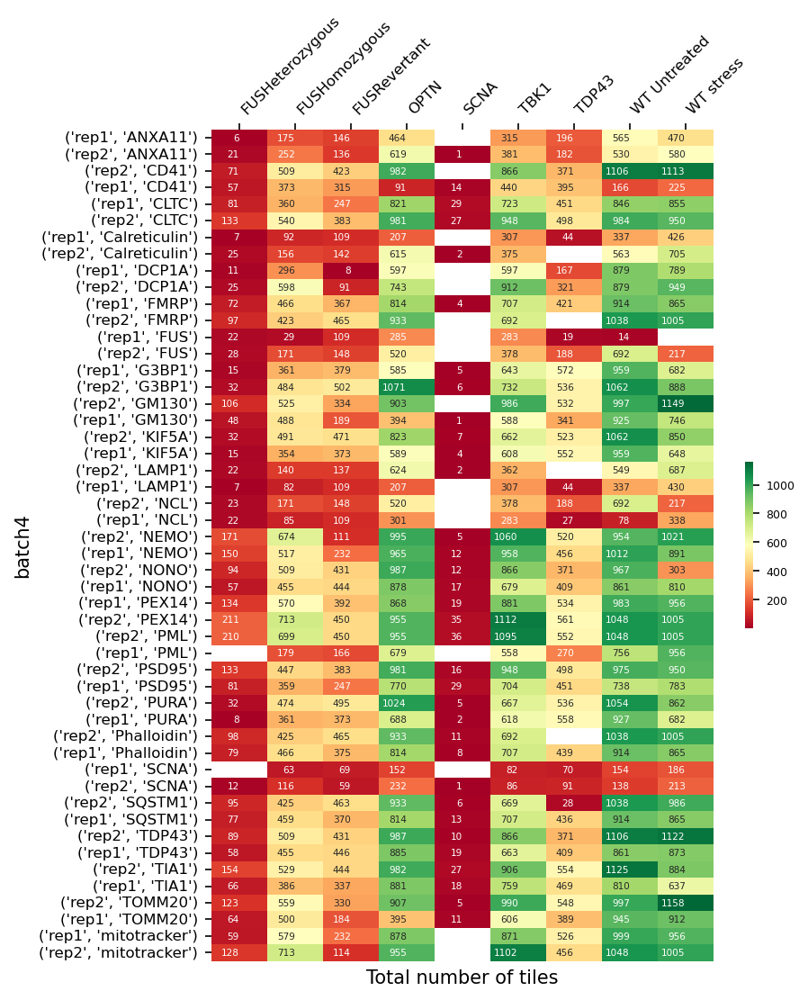

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


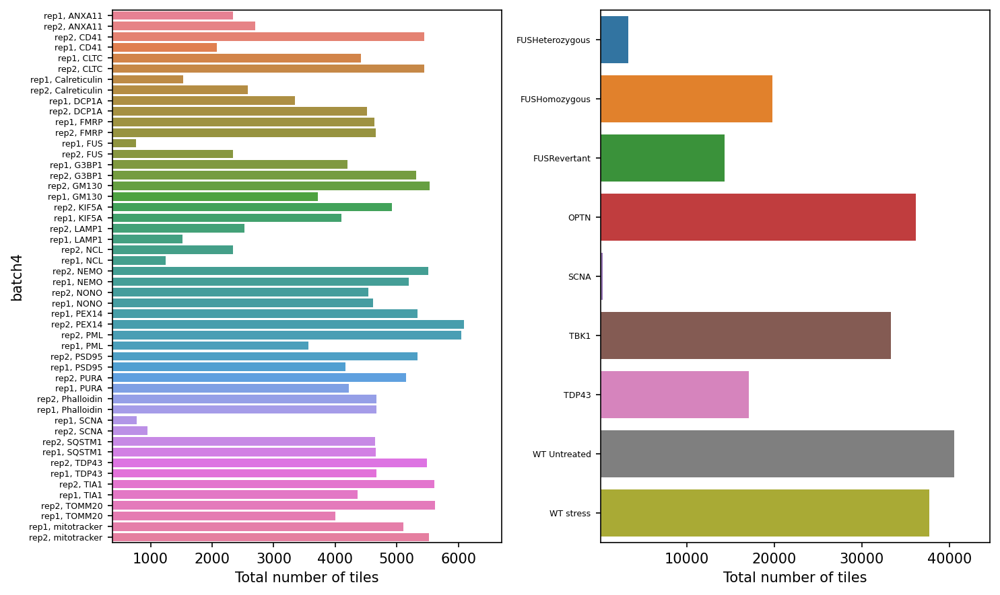

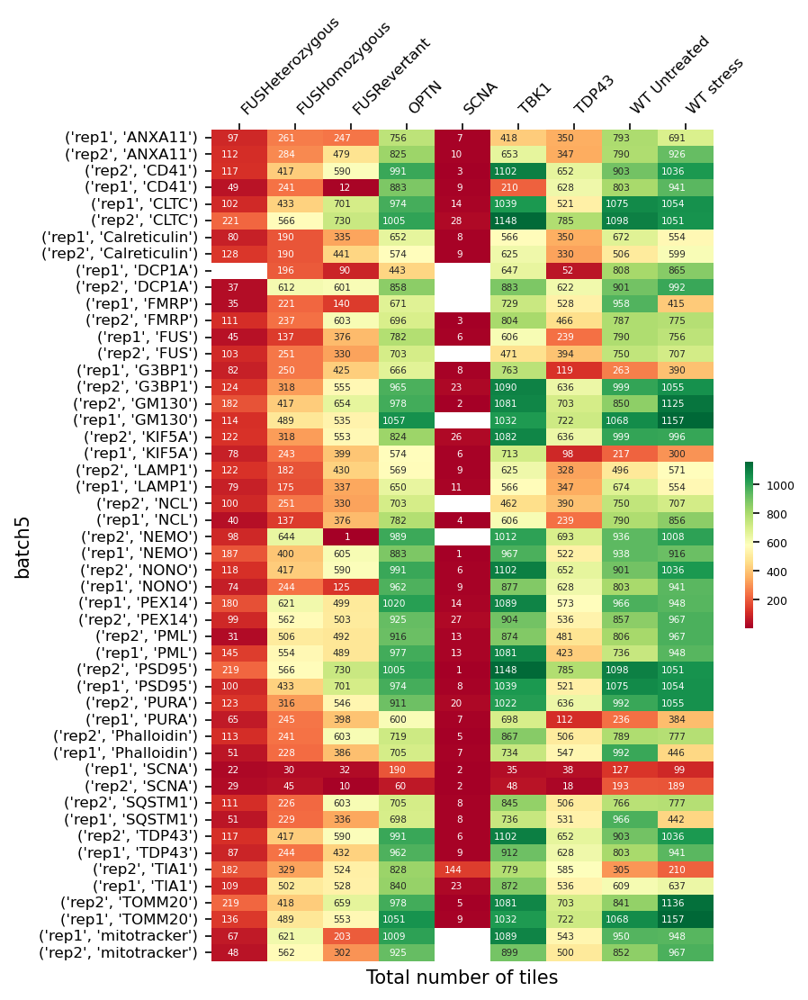

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


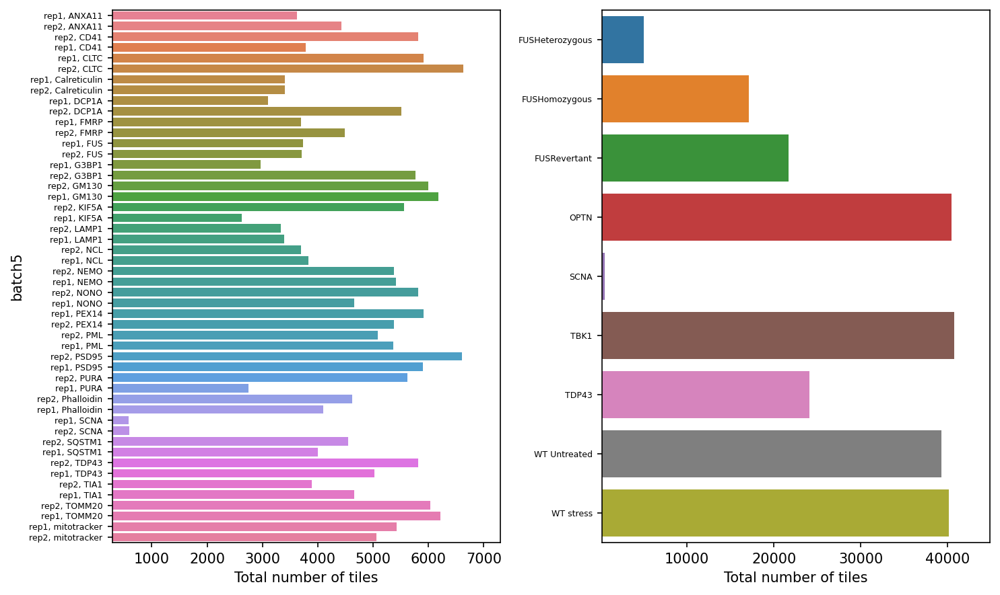

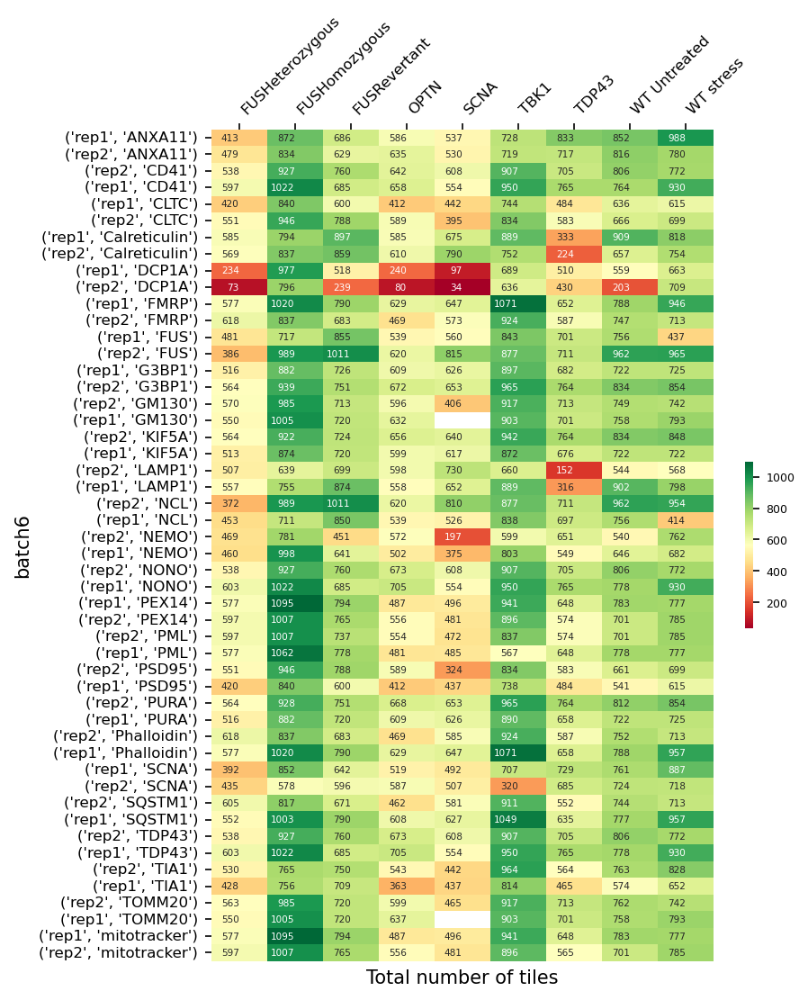

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


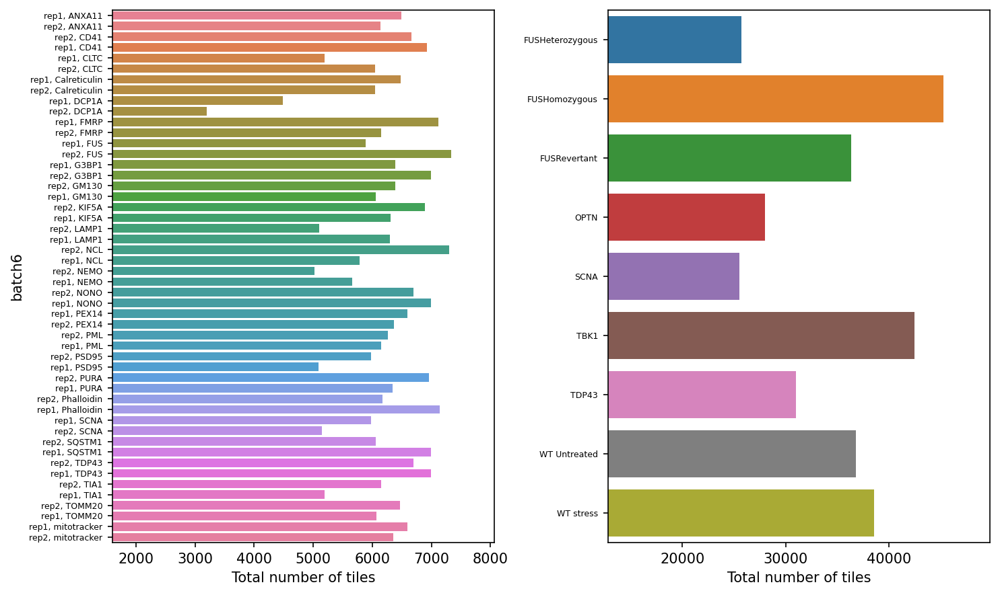

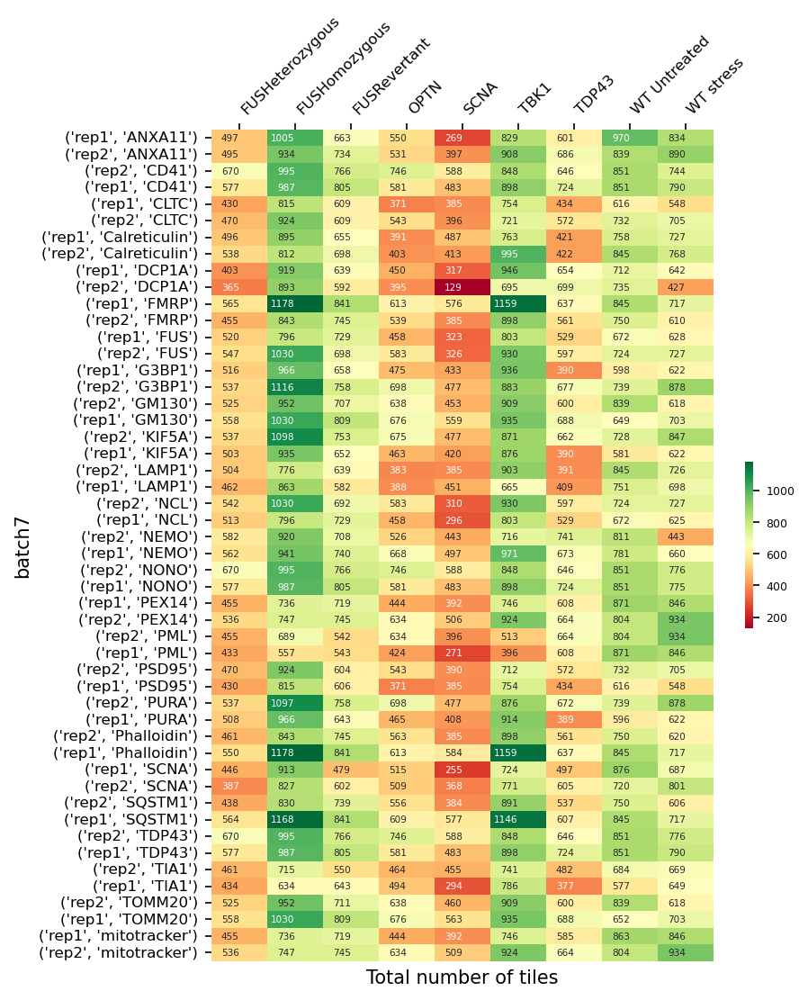

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


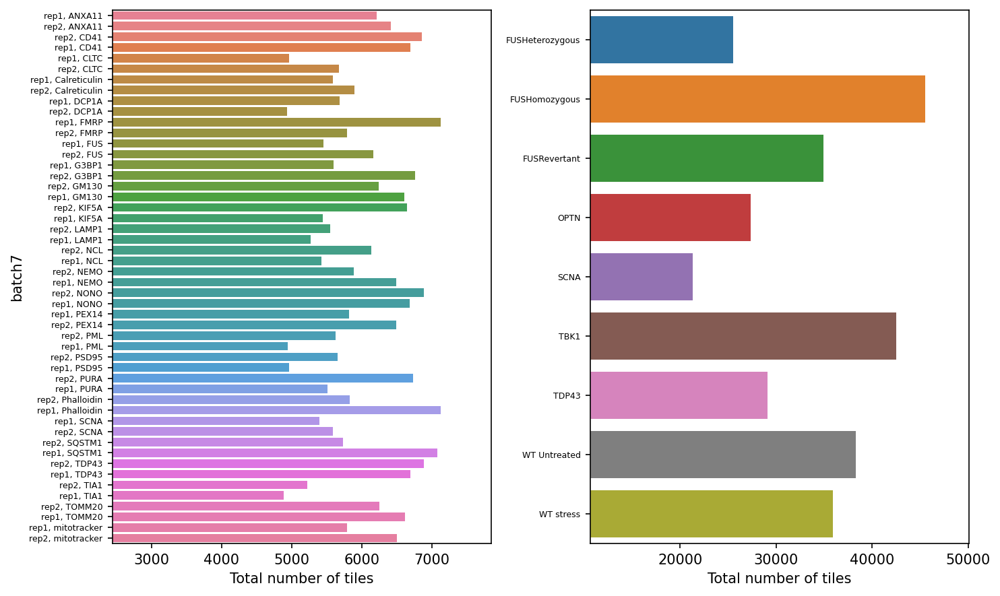

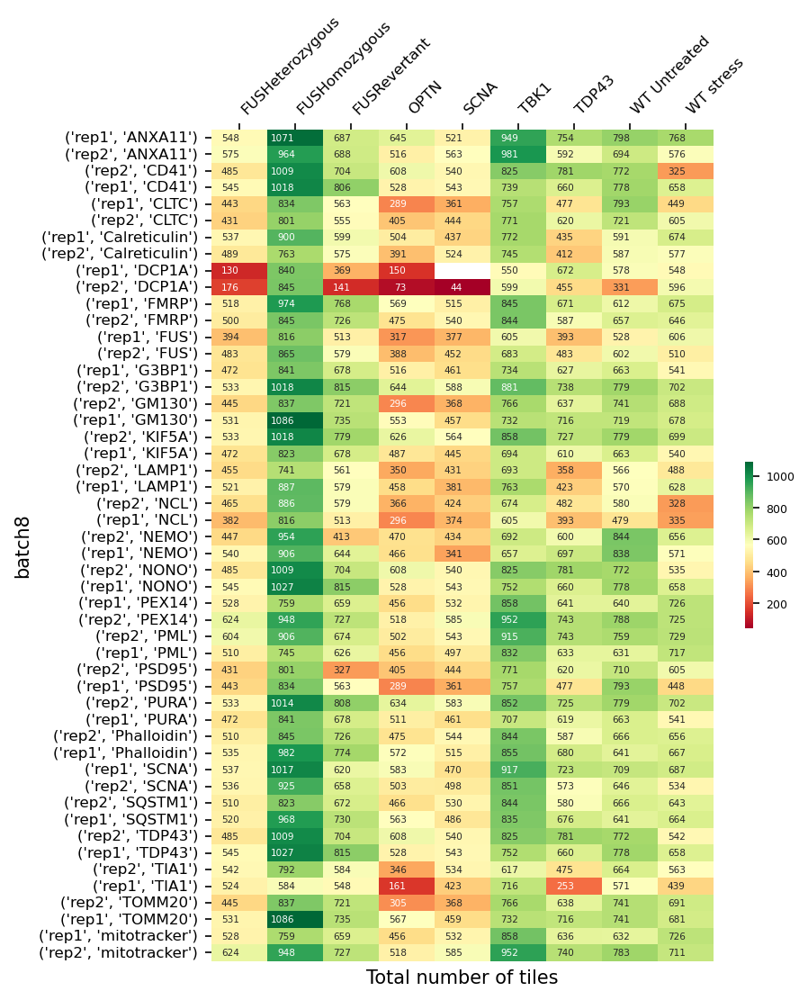

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


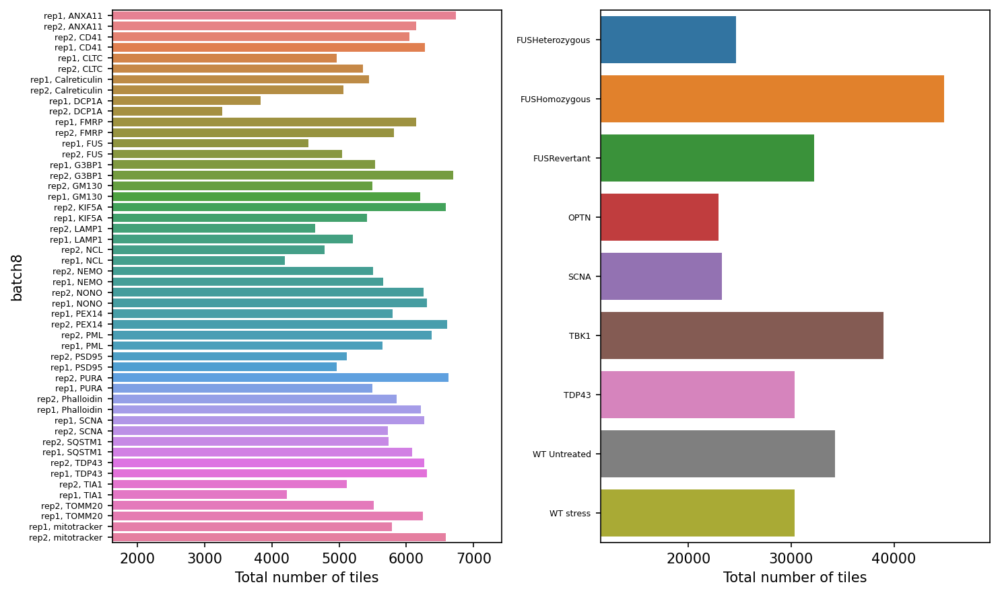

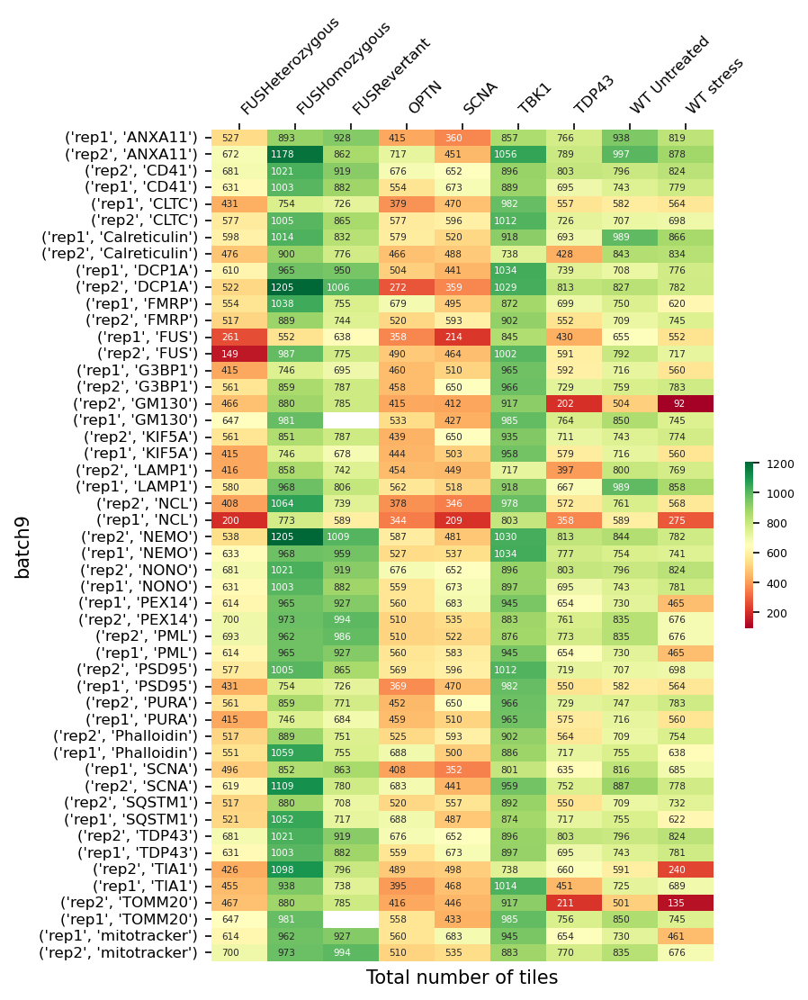

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


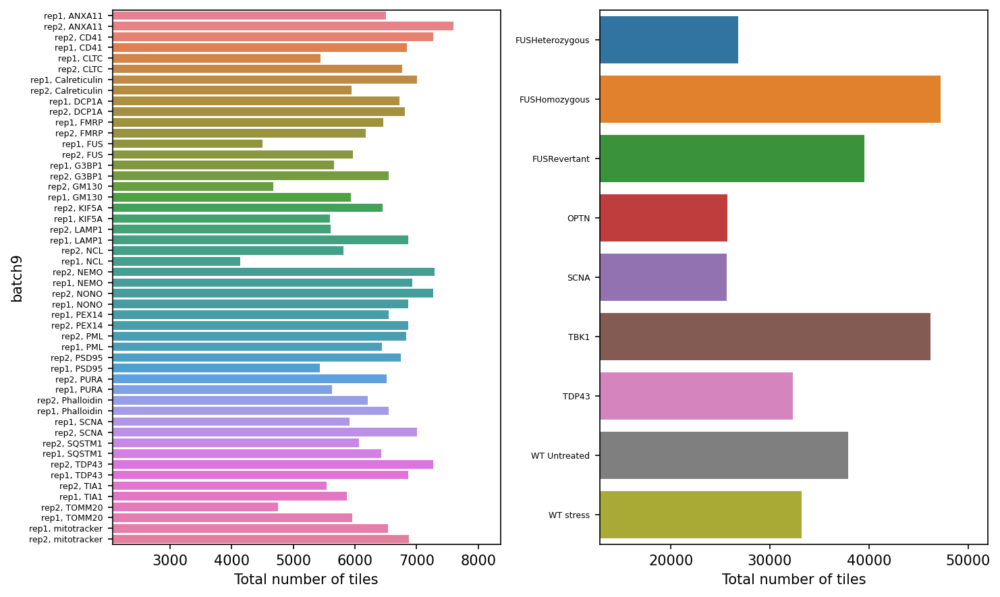

In [28]:
to_heatmap = total_sum.rename(columns={'n_valid_tiles':'index'})
plot_filtering_heatmap(to_heatmap, extra_index='marker', vmin=None, vmax=None,
                      xlabel = 'Total number of tiles', show_sum=True, figsize=(6,8))

### Show Total Whole Cell Counts
For each batch, cell line, replicate and markerTotal number of tiles

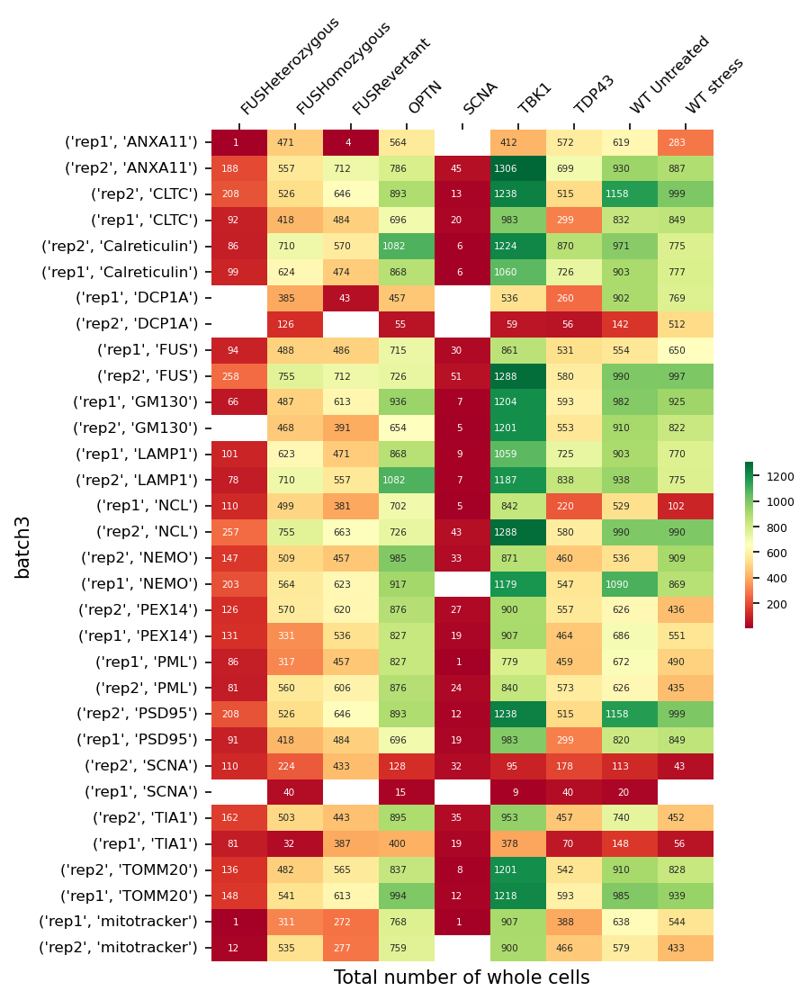

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


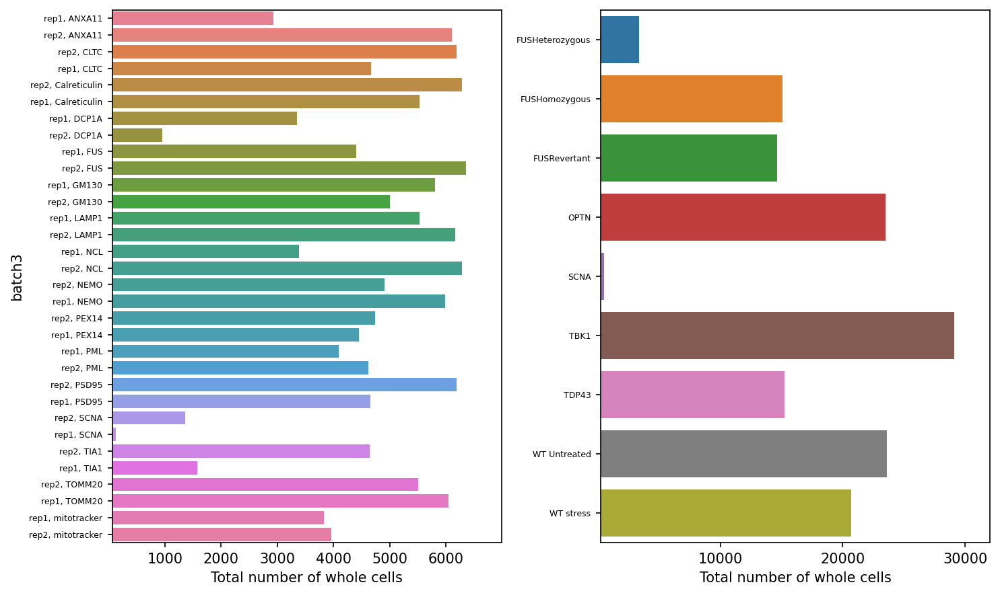

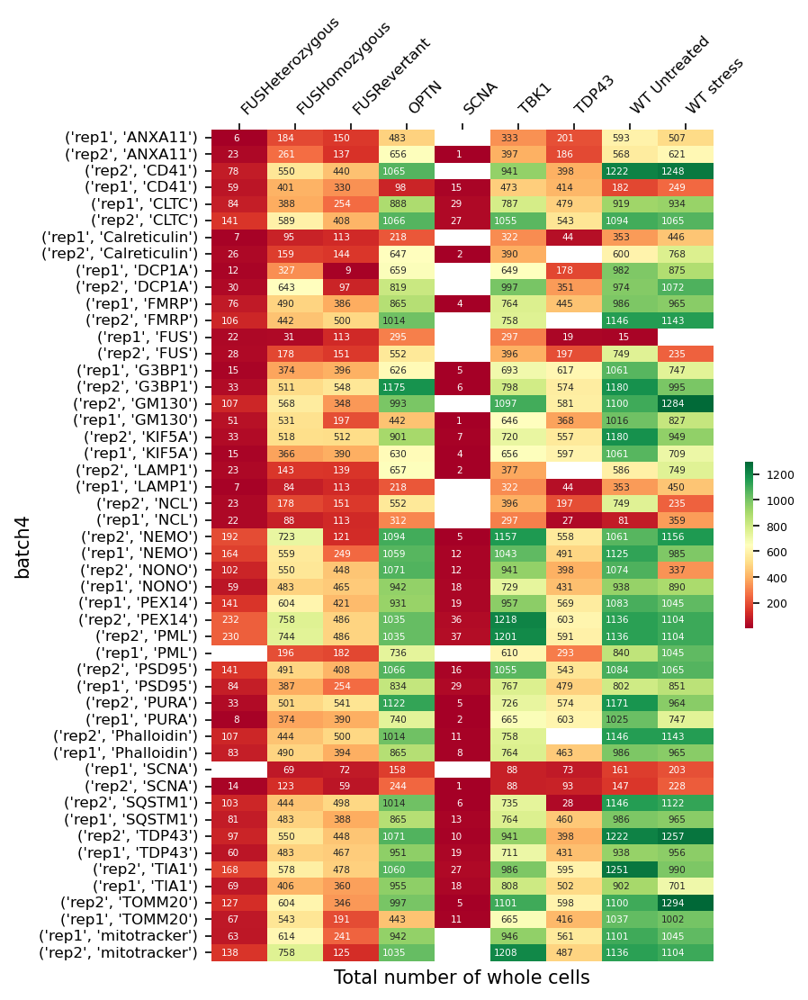

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


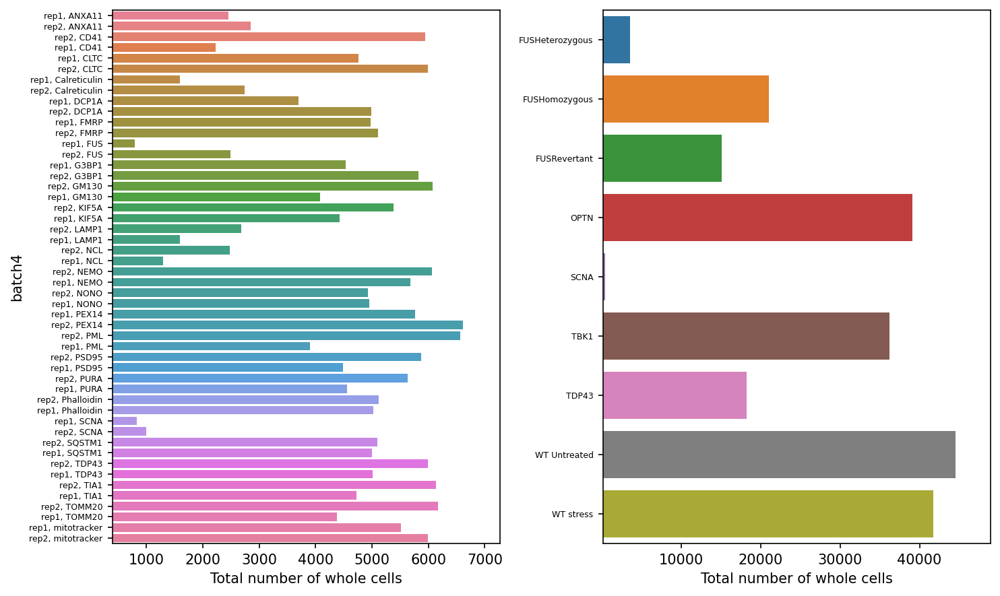

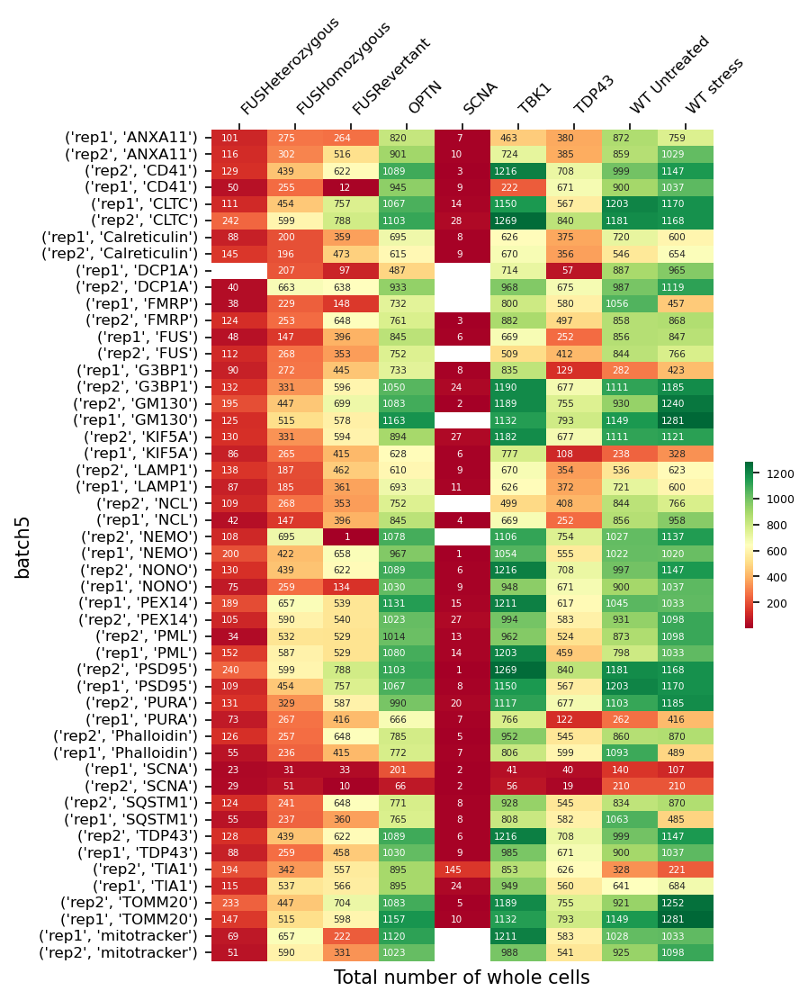

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


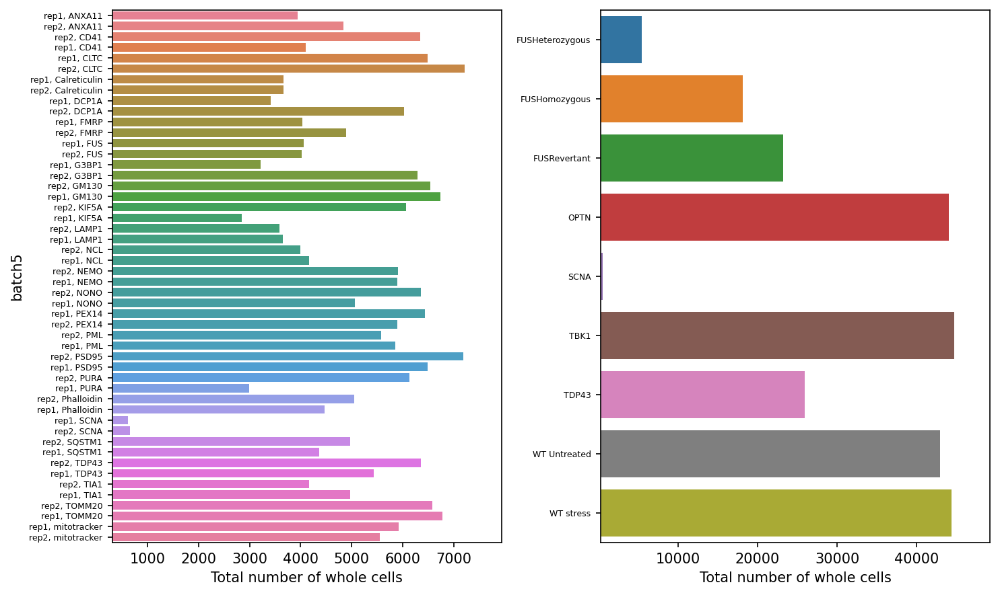

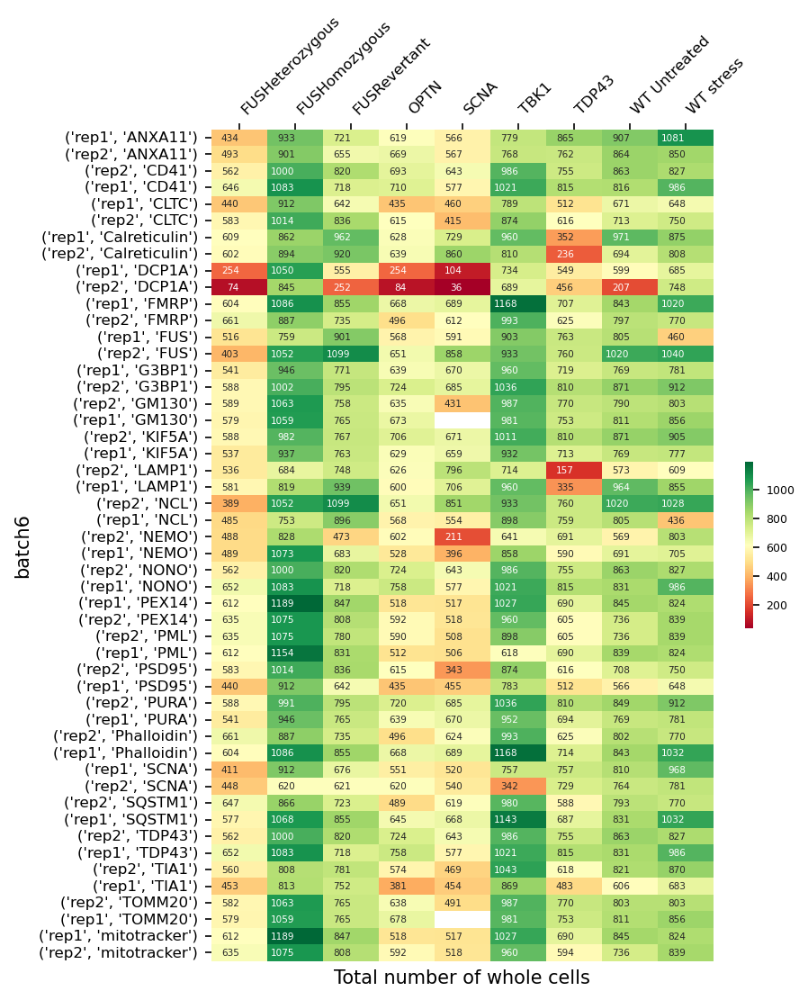

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


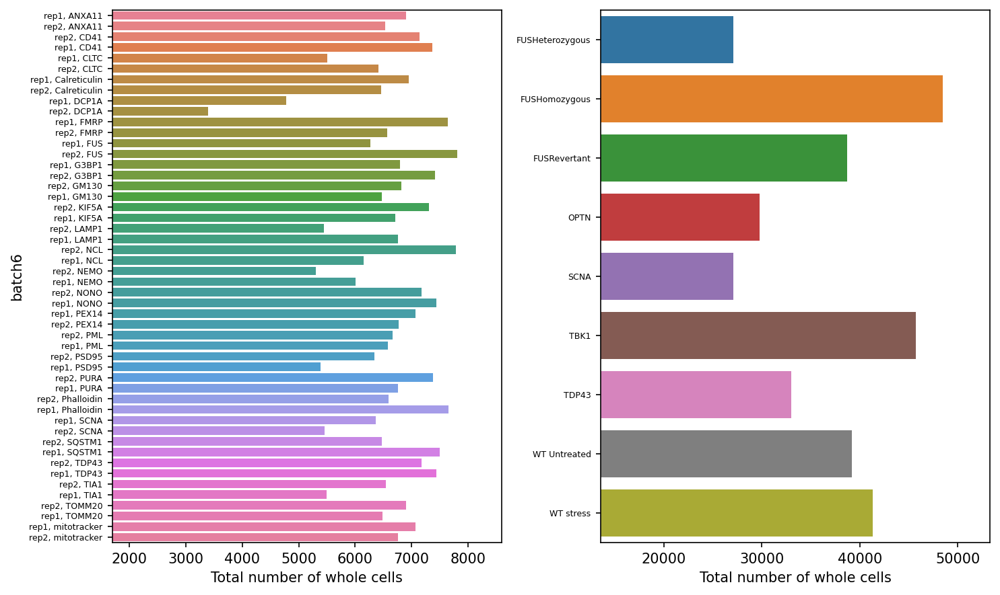

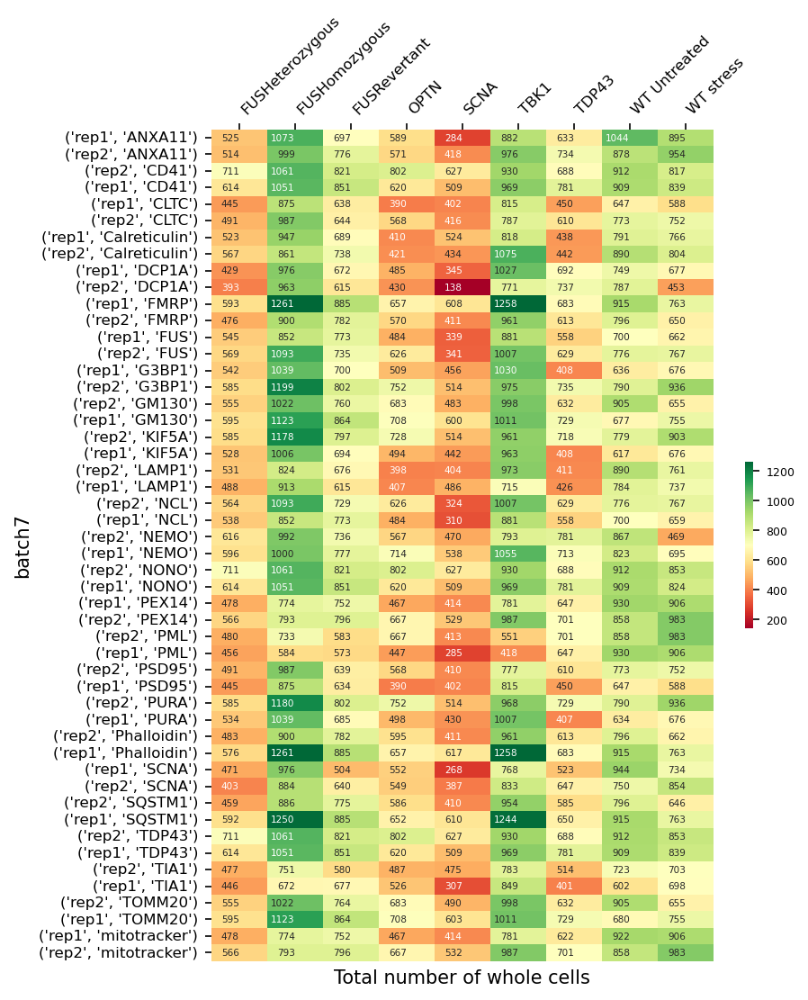

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


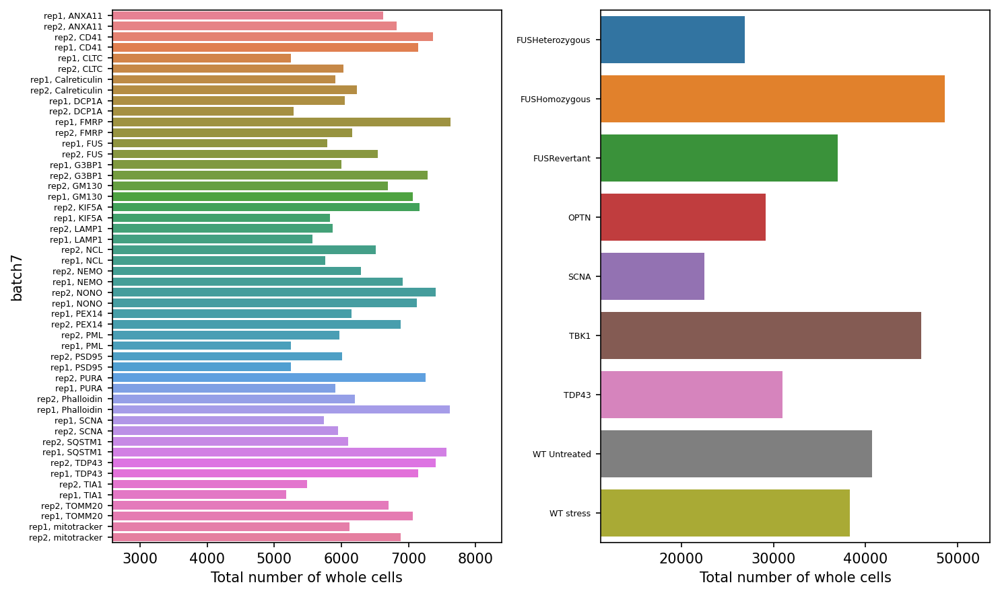

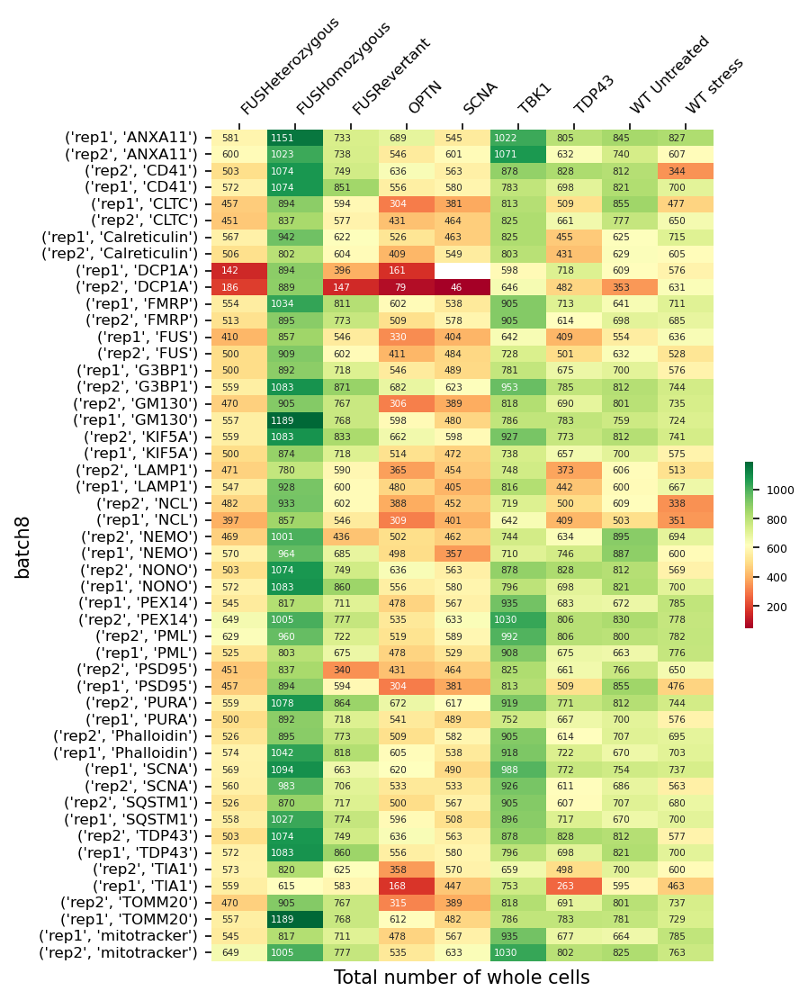

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


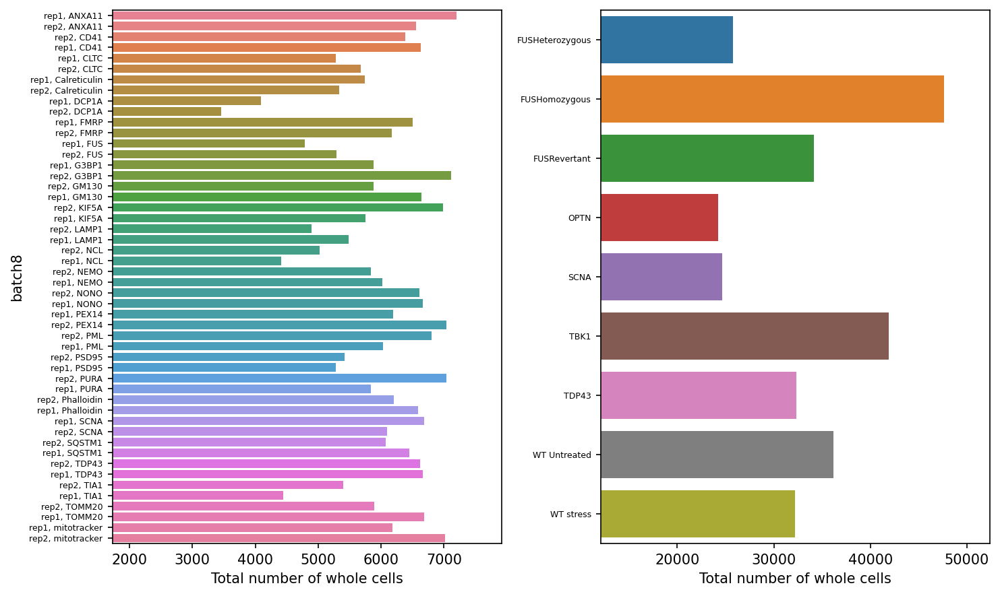

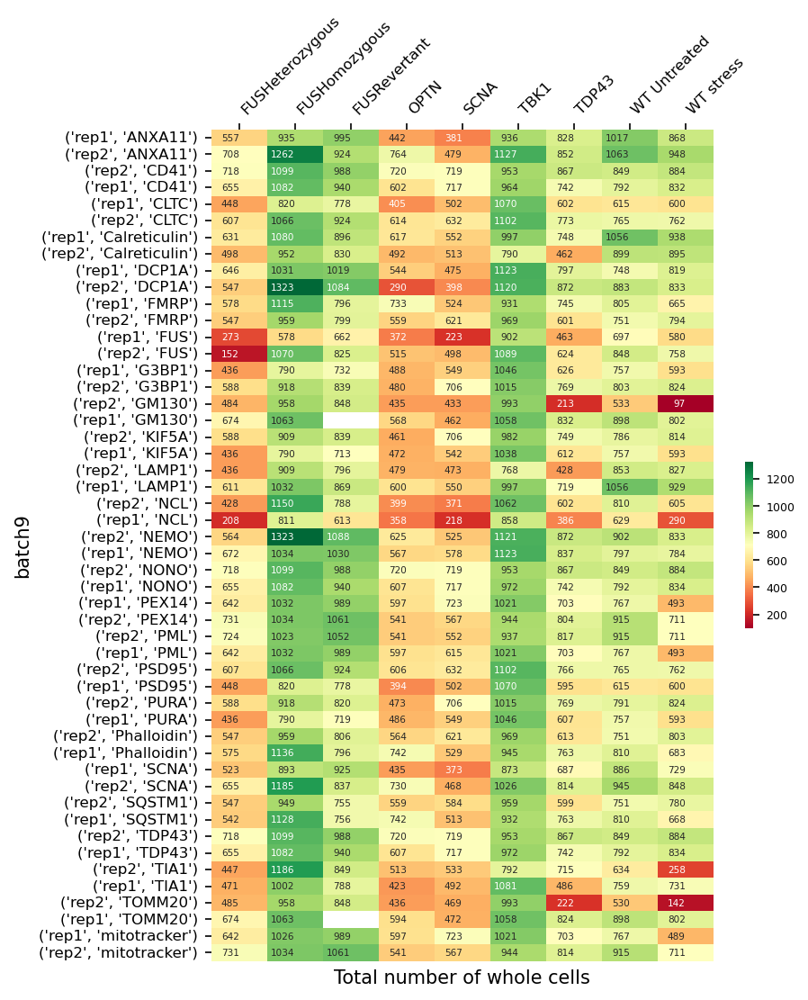

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)
/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:394: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels(ax.get_yticklabels(), fontsize=6)


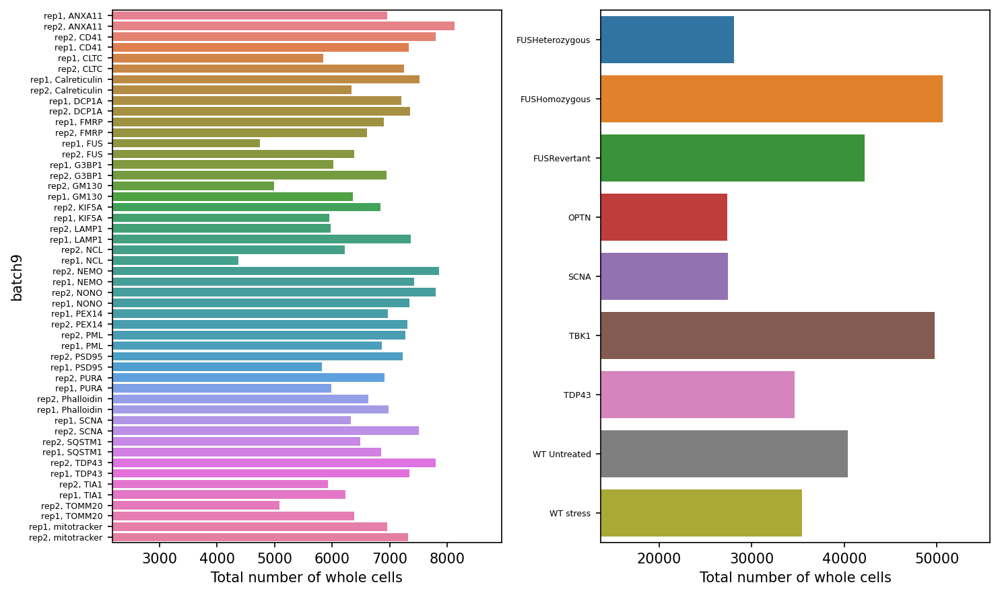

In [29]:
to_heatmap = total_sum.rename(columns={'site_whole_cells_counts_sum':'index'})
plot_filtering_heatmap(to_heatmap, extra_index='marker', vmin=None, vmax=None,
                      xlabel = 'Total number of whole cells', show_sum=True, figsize=(6,8))

### Show **Cell Count** Statistics per Batch

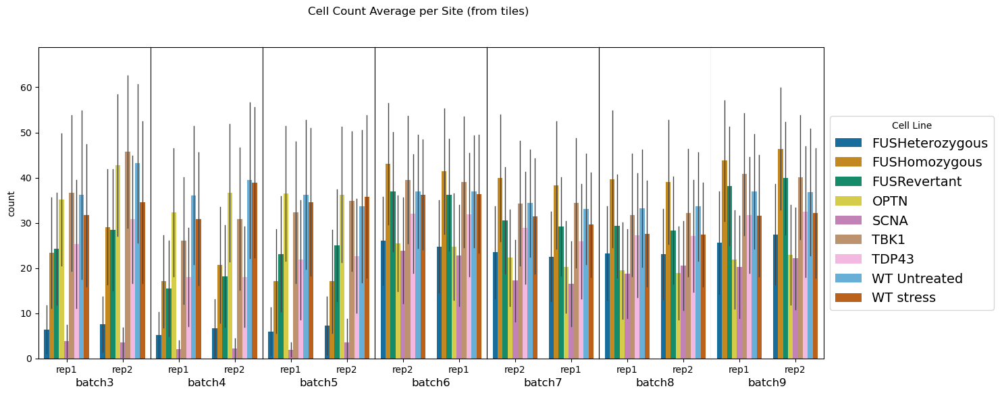

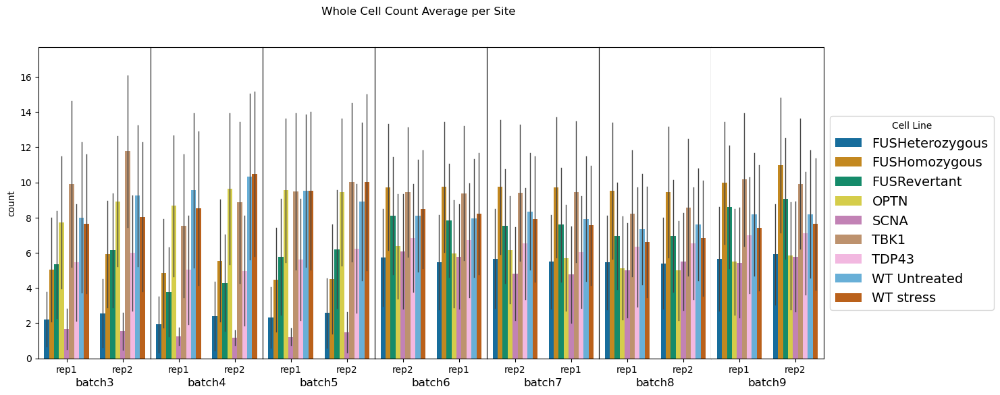

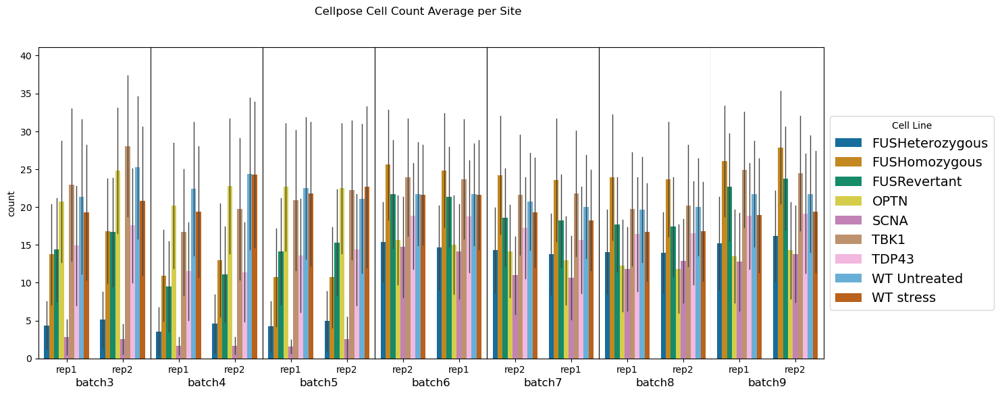

In [30]:
df_no_empty_sites = df_dapi[df_dapi.n_valid_tiles !=0]
plot_cell_count(df_no_empty_sites, lines_order, custom_palette, y='site_cell_count_sum', 
                title='Cell Count Average per Site (from tiles)')

plot_cell_count(df_no_empty_sites, lines_order, custom_palette, y='site_whole_cells_counts_sum',
                title='Whole Cell Count Average per Site')

plot_cell_count(df_no_empty_sites, lines_order, custom_palette, y='site_cell_count',
               title='Cellpose Cell Count Average per Site')


### Show **Tiles** per Site Statistics


In [31]:
df_dapi.groupby(['cell_line_cond']).n_valid_tiles.mean()

cell_line_cond
FUSHeterozygous    3.718508
FUSHomozygous      7.280668
FUSRevertant       6.227143
OPTN               6.467548
SCNA               3.187527
TBK1               8.581333
TDP43              5.641700
WT Untreated       7.857475
WT stress          7.422556
Name: n_valid_tiles, dtype: float64

/home/labs/hornsteinlab/Collaboration/MOmaps_Noam/MOmaps/tools/preprocessing_tools/qc_utils.py:1051: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'batch_rep'] = df['batch'] + " " + df['rep']


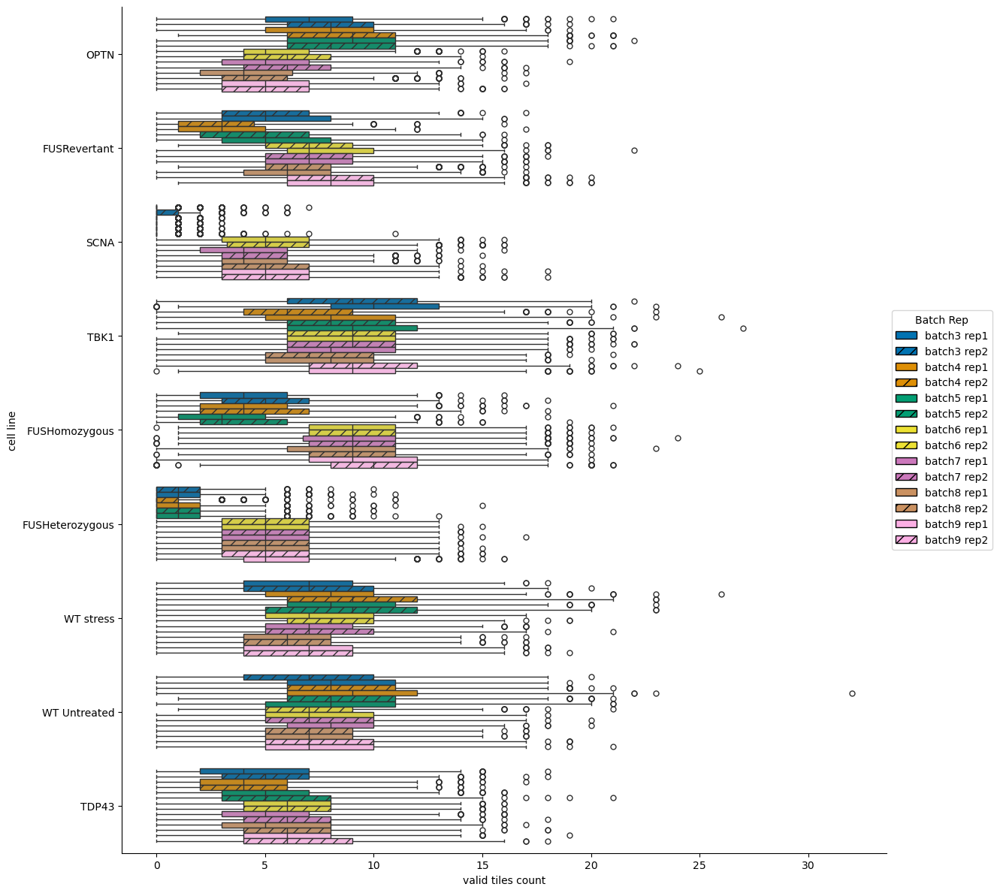

In [32]:
plot_catplot(df_dapi, custom_palette,reps, x='n_valid_tiles', x_title='valid tiles count', batch_min=3, batch_max=9)


### Show Mean of cell count in valid tiles

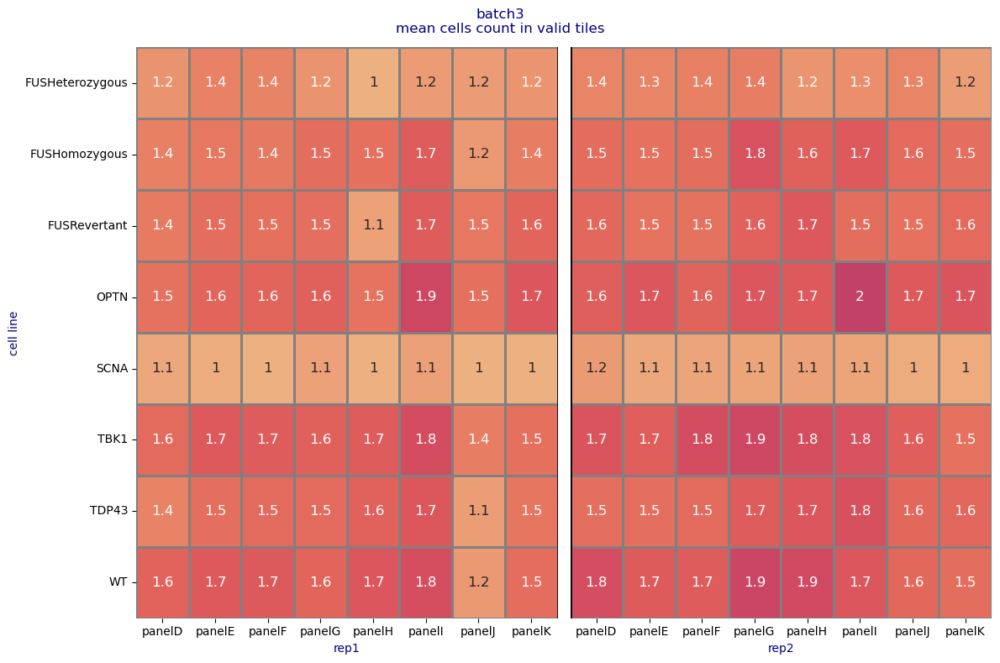

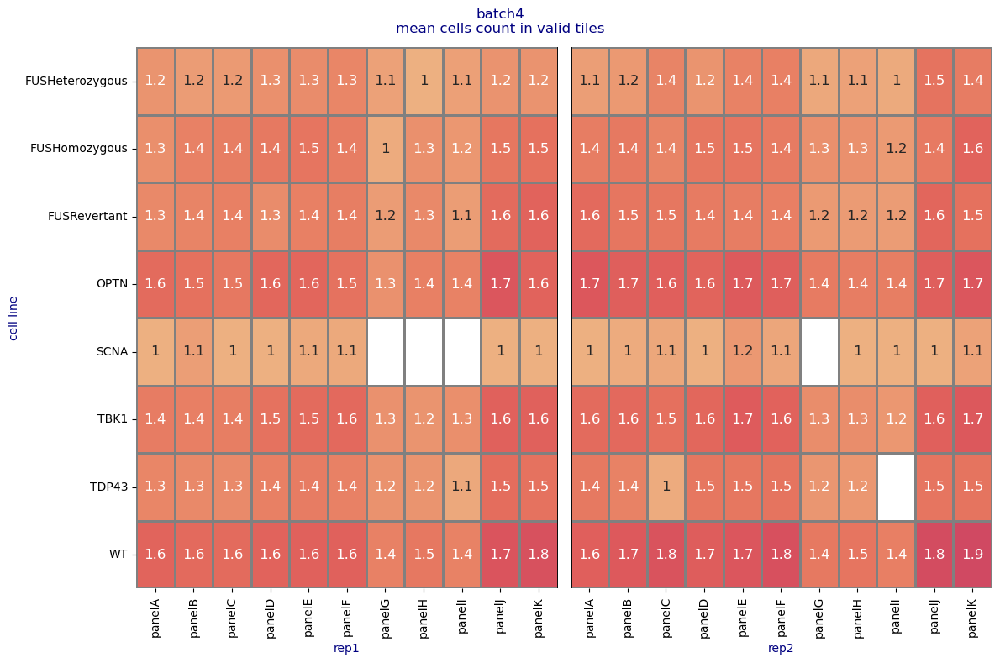

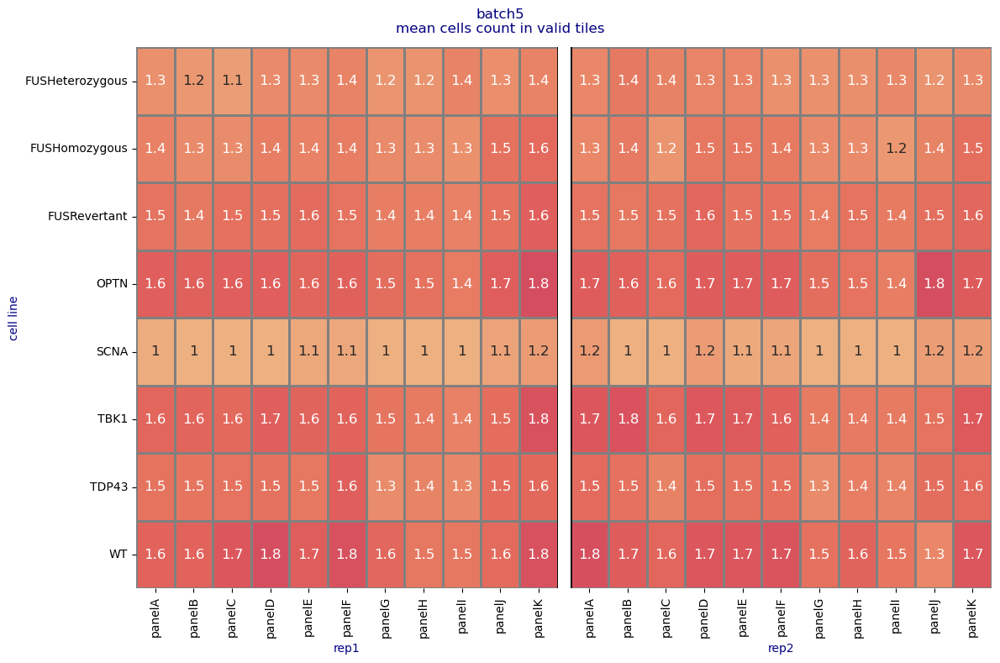

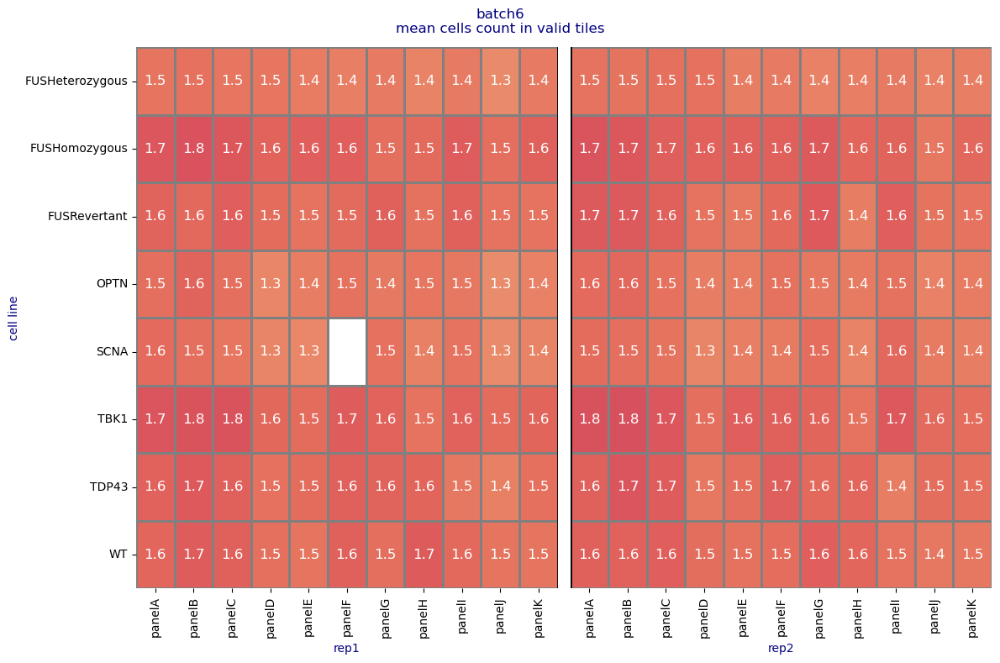

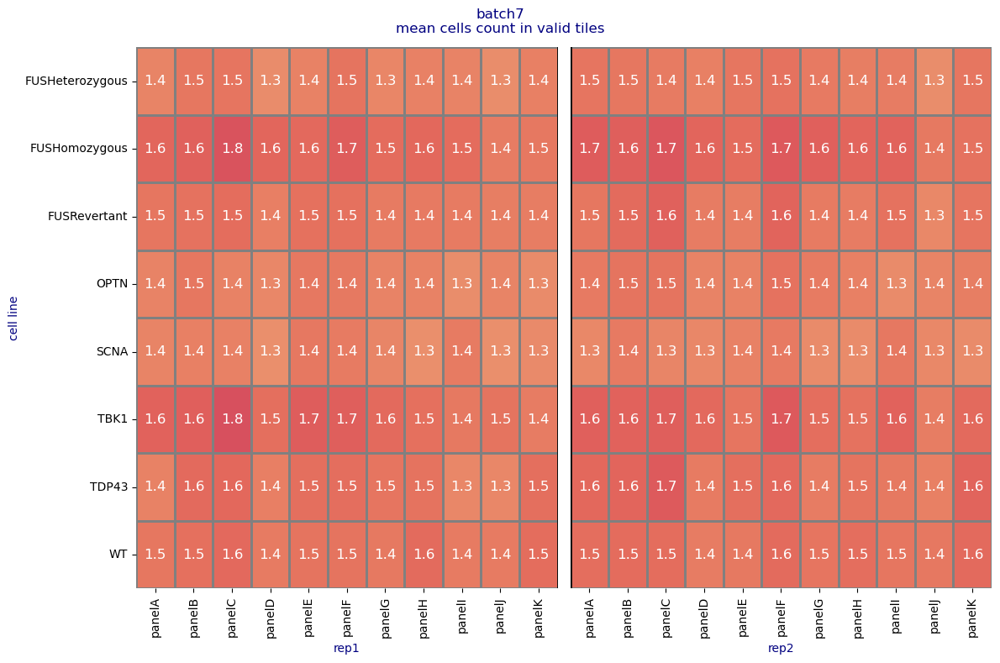

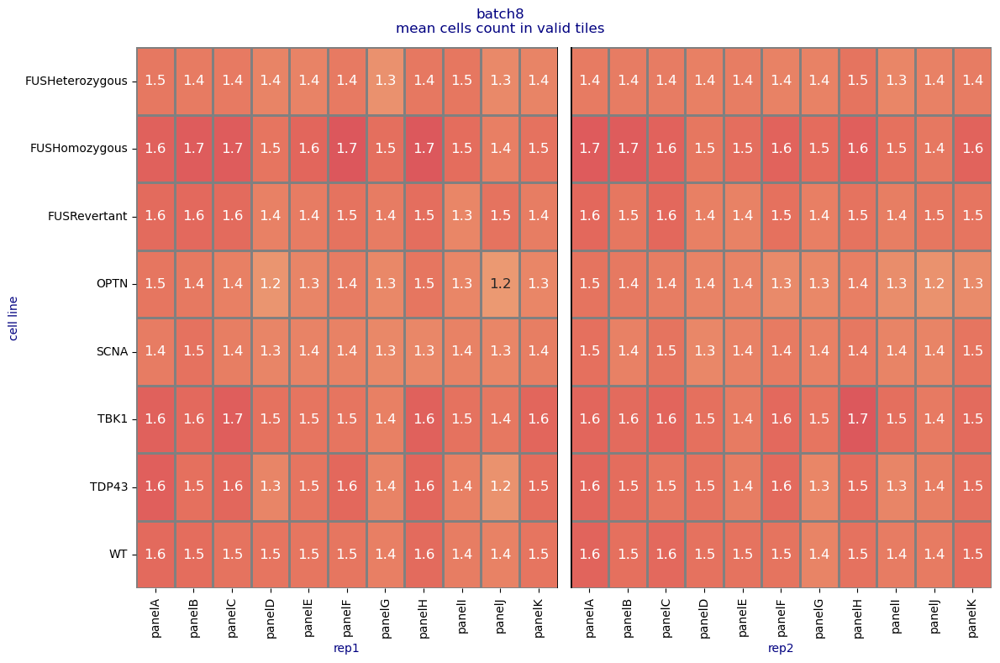

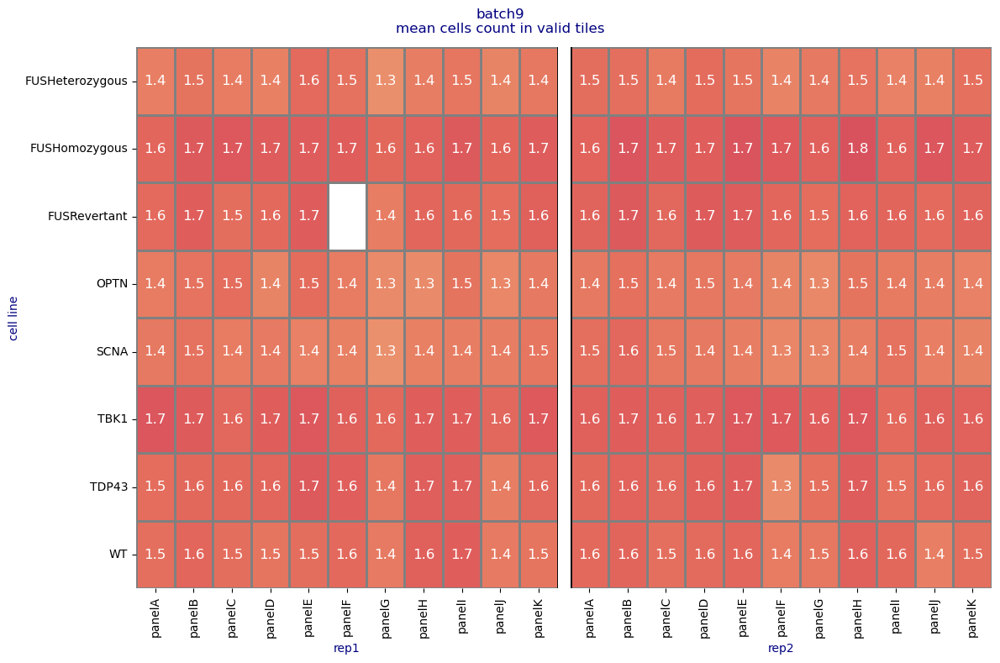

In [33]:
plot_hm(df_dapi, split_by='rep', rows='cell_line', columns='panel')

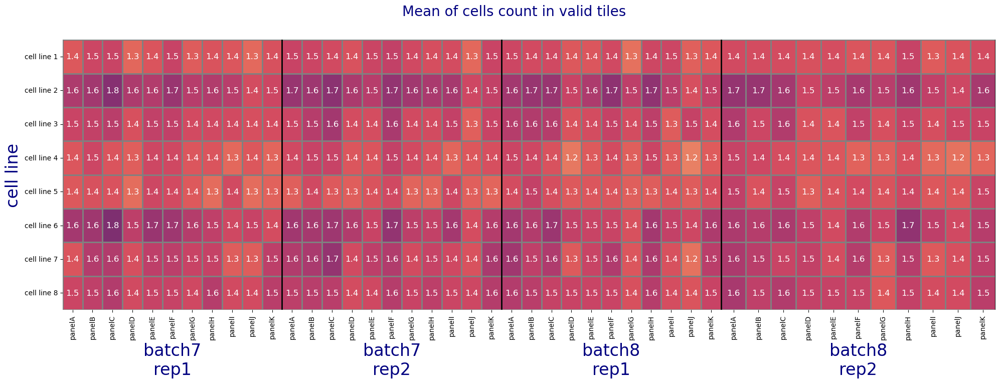

In [38]:
## Only batches 7&8
plot_hm_combine_batches(df_dapi,  batches=['batch7','batch8'], 
                        reps = ['rep1','rep2'],rows='cell_line', columns='panel')


# Assessing Staining Reproducibility and Outliers

In [ ]:
for batch in batches:
    print(batch)
    #batch_num = batch.replace('batch',"")
    run_calc_hist_new(batch,cell_lines_for_disp, markers, 
                           hist_sample=10,sample_size_per_markers=200, ncols=7, nrows=4)
    print("="*30)

In [138]:
# save notebook as HTML ( the HTML will be saved in the same folder the original script is)
display(Javascript('IPython.notebook.save_checkpoint();'))
os.system('jupyter nbconvert --to html src/preprocessing/notebooks/no_ds/qc_report_newPP.ipynb')

<IPython.core.display.Javascript object>

[NbConvertApp] Converting notebook src/preprocessing/notebooks/no_ds/qc_report_newPP.ipynb to html
[NbConvertApp] Writing 33652250 bytes to src/preprocessing/notebooks/no_ds/qc_report_newPP.html


0